In [10]:
!pip uninstall opencv-python
!pip install opencv-contrib-python


You should consider upgrading via the '/home/vlad/.local/bin/.virtualenvs/unet/bin/python -m pip install --upgrade pip' command.


In [1]:
import argparse
import logging
import os

import numpy as np
import torch
import torch.nn.functional as F
from PIL import Image
from torchvision import transforms

from unet import UNet
from utils.data_vis import plot_img_and_mask
from utils.dataset import BasicDataset
import cv2

import matplotlib.pyplot as plt
%matplotlib inline
import cv2

import random

In [2]:
def predict_img(net,
                full_img,
                device,
                scale_factor=1,
                out_threshold=0.5):
    net.eval()

    img = torch.from_numpy(BasicDataset.preprocess(full_img, scale_factor))

    img = img.unsqueeze(0)
    img = img.to(device=device, dtype=torch.float32)

    with torch.no_grad():
        output = net(img)

        print(output.shape)
        #if net.n_classes > 1:
        #    probs = F.softmax(output, dim=1)
        #else:
        #    probs = torch.sigmoid(output)
        probs_0 = torch.sigmoid(output[:, 0, :, :])
        probs_1 = torch.sigmoid(output[:, 1, :, :])

        probs_0 = probs_0.squeeze(0)
        probs_1 = probs_1.squeeze(0)

        tf = transforms.Compose(
            [
                transforms.ToPILImage(),
                #transforms.Resize(full_img.width),#size[1]),
                transforms.Resize((full_img.height, full_img.width)),
                transforms.ToTensor()
            ]
        )

        probs_0 = tf(probs_0.cpu())
        probs_1 = tf(probs_1.cpu())
        mask_0 = probs_0.squeeze().cpu().numpy()
        mask_1 = probs_1.squeeze().cpu().numpy()
        full_mask = np.array([mask_0, mask_1])#probs.squeeze().cpu().numpy()

    return full_mask# > out_threshold


In [3]:
def get_output_filenames(args):
    in_files = args.input
    out_files = []

    if not args.output:
        for f in in_files:
            pathsplit = os.path.splitext(f)
            out_files.append("{}_OUT{}".format(pathsplit[0], pathsplit[1]))
    elif len(in_files) != len(args.output):
        logging.error("Input files and output files are not of the same length")
        raise SystemExit()
    else:
        out_files = output

    return out_files

In [4]:
def mask_to_image(mask):
    return Image.fromarray((mask * 255).astype(np.uint8))

In [5]:
scale = 0.5
mask_threshold = 0.5 #минимальная вероятность для рассматривания пикселя на маску

no_save = True
viz = False

In [6]:
model = 'ckpts_dir/mid_ckpts/CP_epoch300.pth'

# /CP_epoch200.pth - класс!

net = UNet(n_channels=1, n_classes=2)

logging.info("Loading model {}".format(model))

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
logging.info(f'Using device {device}')
net.to(device=device)
net.load_state_dict(torch.load(model, map_location=device))

logging.info("Model loaded !")

In [7]:
#indirimg = '/home/ubuntu/T2_Sag_Mid/test_data/imgs/'
#imdirmask = '/home/ubuntu/T2_Sag_Mid/test_data/masks/'

#infile_list = os.listdir(indirimg)
#inmask_list = os.listdir(imdirmask)

In [8]:
#infile_list[:3], inmask_list[:3]

torch.Size([1, 2, 240, 256])


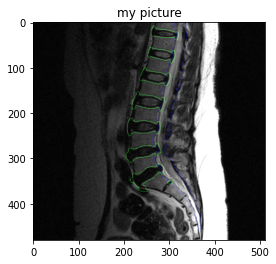

In [10]:
my_file = '/home/vlad/Mask_RCNN/00002.PNG'
img = Image.open(my_file)
#img

mask = predict_img(net=net,
                   full_img=img,
                   scale_factor=scale,
                   out_threshold=mask_threshold,
                   device=device)

res_treshold = 0.05

mask = np.array([mask[0] > res_treshold, mask[1] > res_treshold], dtype=np.uint8)

#kernel = np.ones((10,10),np.uint8)
#mask[0] = cv2.morphologyEx(mask[0], cv2.MORPH_OPEN, kernel)
#mask[1] = cv2.morphologyEx(mask[1], cv2.MORPH_OPEN, kernel)
vertebrae = cv2.Canny(image=mask[0]*255, threshold1=50, threshold2=150)
canal = cv2.Canny(image=mask[1]*255, threshold1=50, threshold2=150)
rgb_contours = np.dstack([np.zeros_like(canal), vertebrae, canal])
img_np = np.array(img)
rgb_mrimg = np.dstack([img, img, img])
result_img = cv2.addWeighted(rgb_mrimg, 1, rgb_contours, 0.5, 0)

#save_path = os.path.abspath(os.path.join('tmp', str(uuid4()) + '.png'))
#cv2.imwrite('/home/vlad/result_test.png', result_img)
#mask_path = save_path[:-4] + '_mask.png'
#cv2.imwrite('/home/vlad/mask.png', rgb_contours)

plt.imshow(result_img)
plt.title('my picture')
plt.show()

torch.Size([1, 2, 240, 256])
[[[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]]
<class 'numpy.ndarray'>


TypeError: Invalid shape (512, 480, 2) for image data

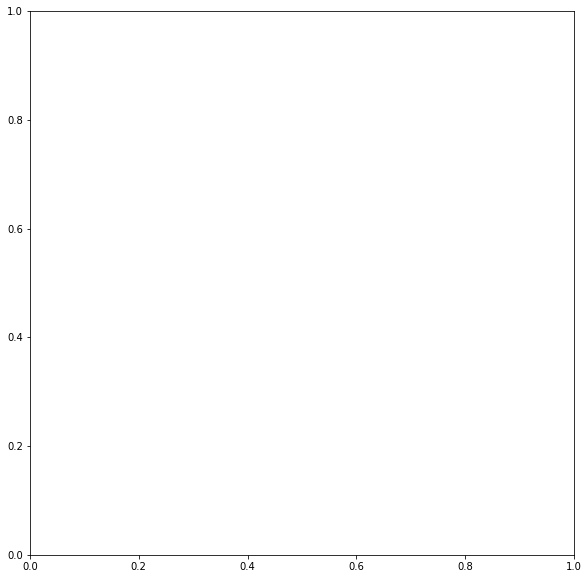

In [29]:
#choise = random.choice(infile_list)
#in_files = indirimg + choise
#in_masks = imdirmask + choise
#print(choise)


my_file = '/home/vlad/Mask_RCNN/00002.PNG'
img = Image.open(my_file)
#img

mask = predict_img(net=net,
                   full_img=img,
                   scale_factor=scale,
                   out_threshold=mask_threshold,
                   device=device)

#print(mask.shape)
#print(np.unique(mask))

#true_mask = cv2.imread(in_masks)
#print(np.unique(true_mask))
'''
plt.figure(figsize=(5,5))
plt.imshow(true_mask[:,:,0] * 255)
plt.show()


plt.figure(figsize=(5,5))
plt.imshow(mask[0])
plt.show()


true_mask = cv2.imread(in_masks)
plt.figure(figsize=(5,5))
plt.imshow(true_mask[:,:,1] * 255)
plt.show()

plt.figure(figsize=(5,5))
plt.imshow(mask[1])
plt.show()
'''
########
### change the threshold param for better / worse results

#img_test = Image.fromarray(mask, 'RGB')
#img.save('my.png')
#img_test.show()


res_treshold = 0.05

mask = np.array([mask[0] > res_treshold, mask[1] > res_treshold], dtype=np.uint8)

#kernel = np.ones((10,10),np.uint8)
#mask[0] = cv2.morphologyEx(mask[0], cv2.MORPH_OPEN, kernel)
#mask[1] = cv2.morphologyEx(mask[1], cv2.MORPH_OPEN, kernel)
vertebrae = cv2.Canny(image=mask[0]*255, threshold1=50, threshold2=150)
canal = cv2.Canny(image=mask[1]*255, threshold1=50, threshold2=150)
rgb_contours = np.dstack([np.zeros_like(canal), vertebrae, canal])
img_np = np.array(img)
rgb_mrimg = np.dstack([img, img, img])
result_img = cv2.addWeighted(rgb_mrimg, 1, rgb_contours, 0.5, 0)

#save_path = os.path.abspath(os.path.join('tmp', str(uuid4()) + '.png'))
cv2.imwrite('/home/vlad/result_test.png', result_img)
#mask_path = save_path[:-4] + '_mask.png'
cv2.imwrite('/home/vlad/mask.png', rgb_contours)


########

plt.figure(figsize=(10,10))
'''
plt.imshow(np.moveaxis(np.array([mask[0,:,:] * 255,
                                 mask[1,:,:] * 255,
                                 (mask[0,:,:] + mask[1,:,:]) * 255]),0, 2))
'''
np_img = np.array(img.resize((mask[0].shape[1], mask[0].shape[0]))) +100

padded_mask = np.zeros((mask[0].shape[0], mask[0].shape[1]), dtype=np.uint8)


#!!!!!
print(mask)
print(type(mask))
#img_test = Image.fromarray(mask, 'RGB')
#img.save('my.png')
#img_test.show()

mask2 = np.transpose(mask, (2,1,0))
plt.imshow(mask2)
plt.imshow(np.moveaxis(np.array([mask[0,:,:] * 255,
                                 mask[1,:,:] * 255,
                                 (mask[0,:,:] + mask[1,:,:]) * 255]),0, 2))

plt.show()

#plt.figure(figsize=(20,20))
#plot_img_and_mask(img, mask)

np_img = np.array(img.resize((mask[0].shape[1], mask[0].shape[0]))) +100

#print('IMAGE',np_img.shape)

plt.figure(figsize=(10,10))
'''
plt.imshow(np.moveaxis(np.array([mask[0,:,:] * np_img,
                                 mask[1,:,:] * np_img,
                                 (mask[0,:,:] + mask[1,:,:]) * np_img]),0, 2))
'''
plt.imshow(np.moveaxis(np.array([mask[0,:,:] * np_img,
                                 mask[1,:,:] * np_img,
                                 np_img]),0, 2))
plt.show()

#plt.figure(figsize=(10,10))
#plt.imshow(img)
#plt.show()

#'''##
figsize = (16,16)
_, ax = plt.subplots(1, figsize=figsize)


ax.axis('off')
#p = (np.array([mask[0,:,:] * 255, mask[1,:,:] * 255,(mask[0,:,:] + mask[1,:,:]) * 255]), 0, 2)
#p = mask[0,:,:]
#ax.add_patch(padded_mask)
ax.imshow(padded_mask.astype(np.uint8))
#'''


print('INFO',mask.shape)
print(type(mask))
print(len(mask))

In [20]:
img_test = Image.fromarray(mask, 'RGB')
#img.save('my.png')
img_test.show()

00311.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803923 0.3019608
 0.30588236 0.30980393 0.3137255  0.31764707 0.32156864 0.3254902
 0.32941177 

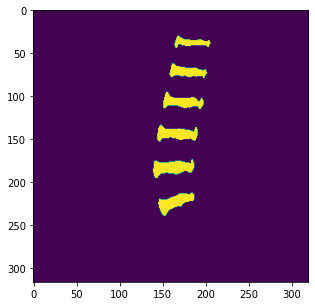

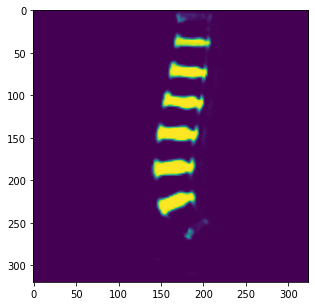

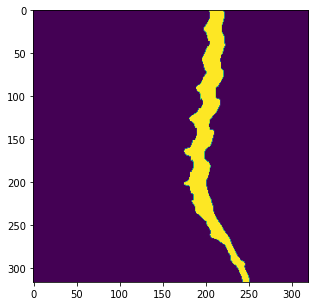

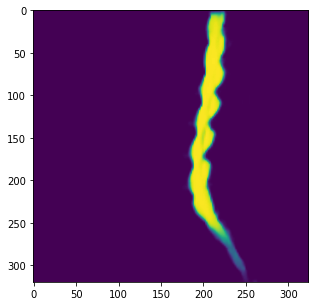

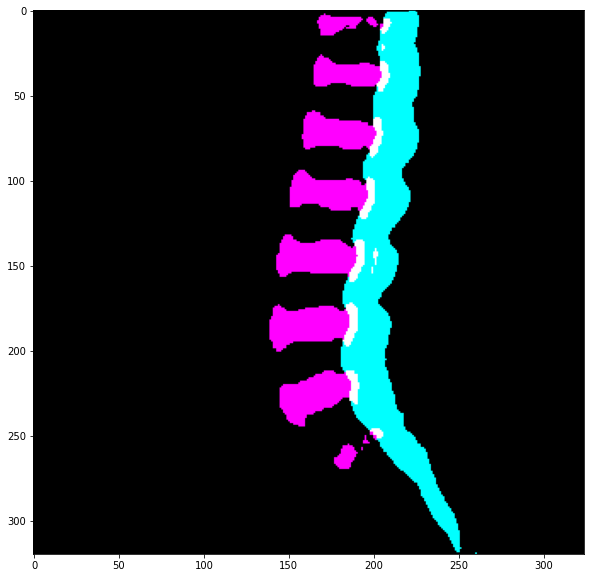

<Figure size 1440x1440 with 0 Axes>

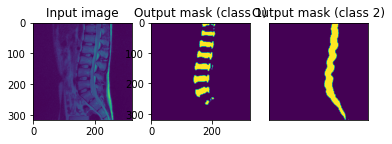

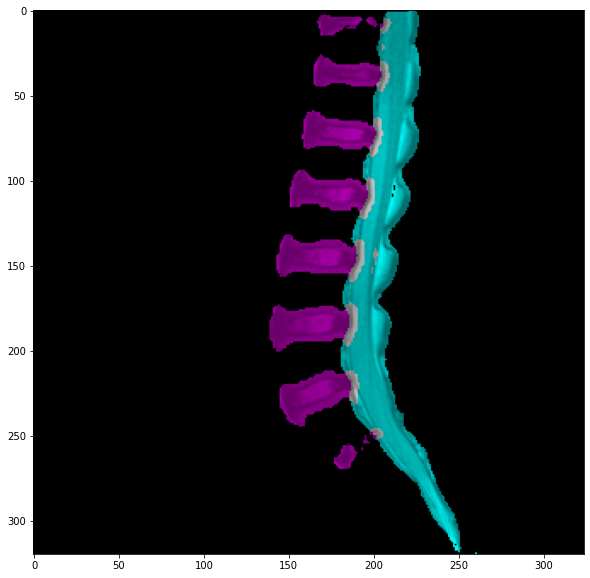

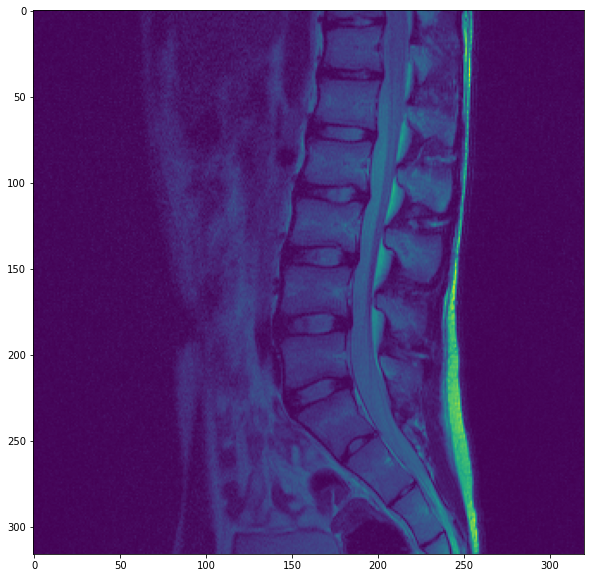

------------------------------------------------------------------------------------------

00263.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

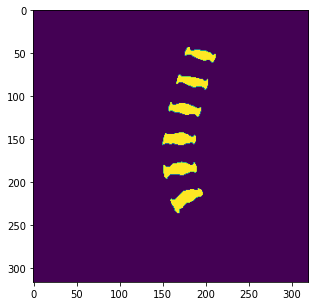

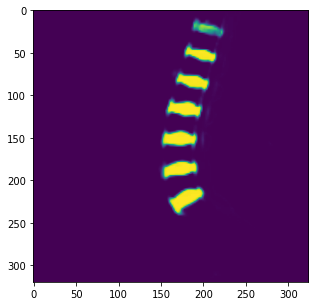

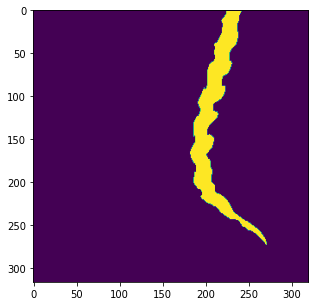

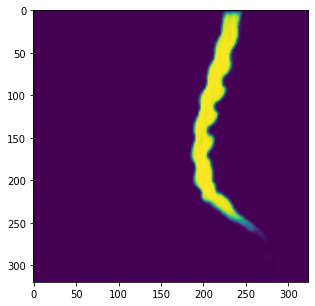

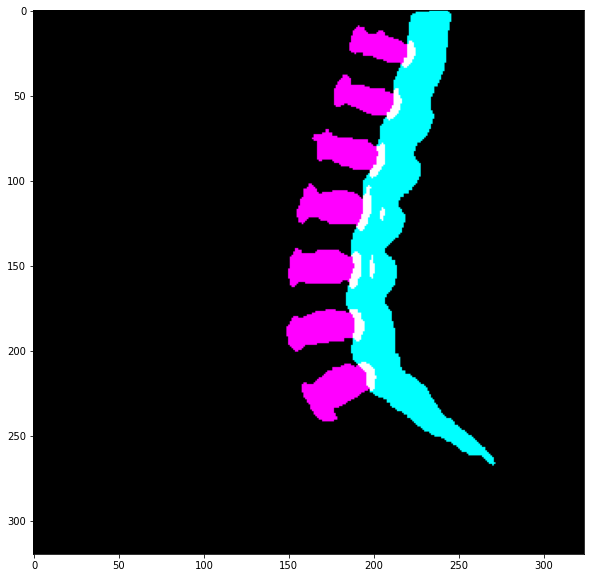

<Figure size 1440x1440 with 0 Axes>

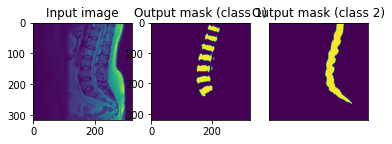

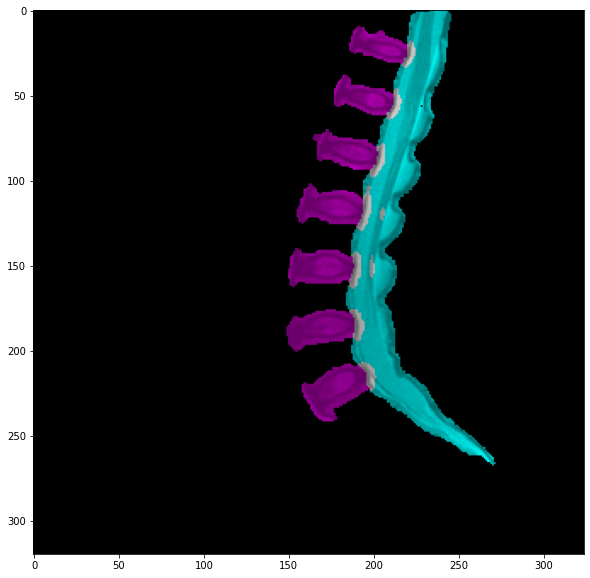

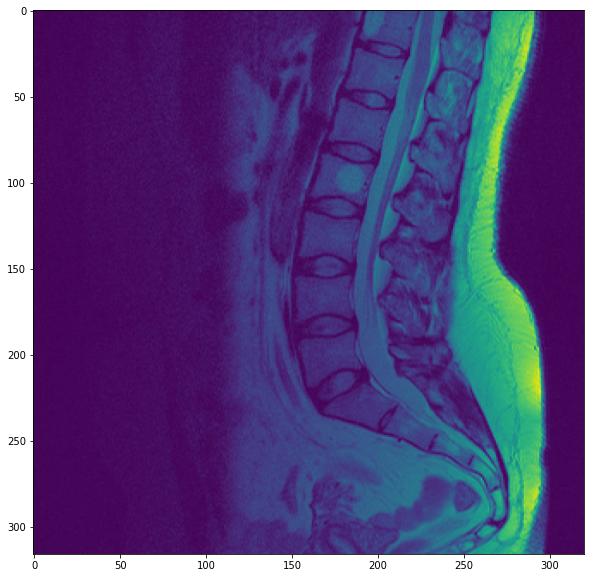

------------------------------------------------------------------------------------------

00035.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

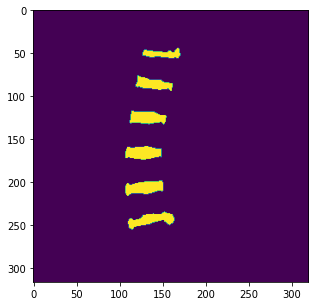

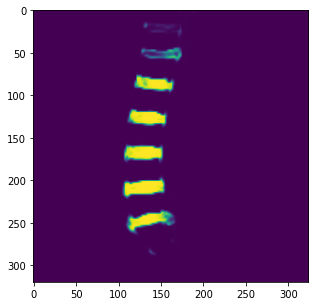

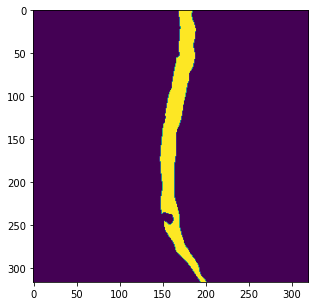

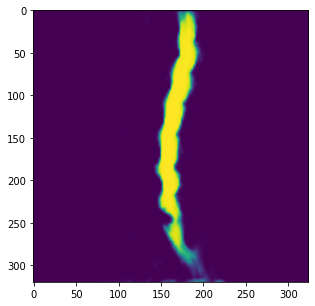

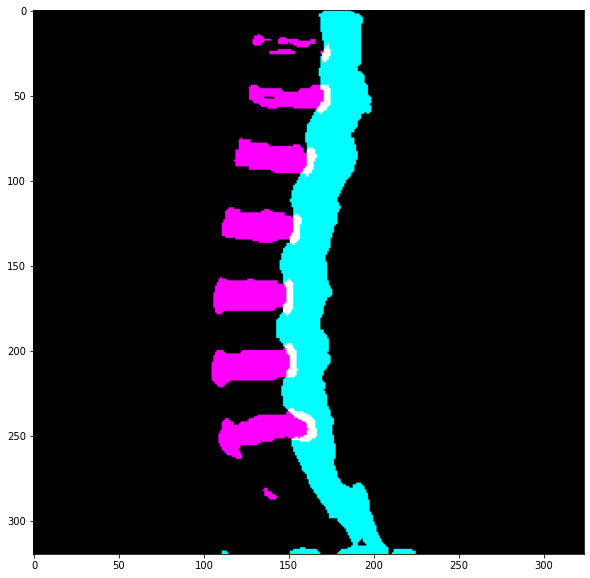

<Figure size 1440x1440 with 0 Axes>

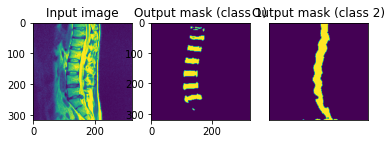

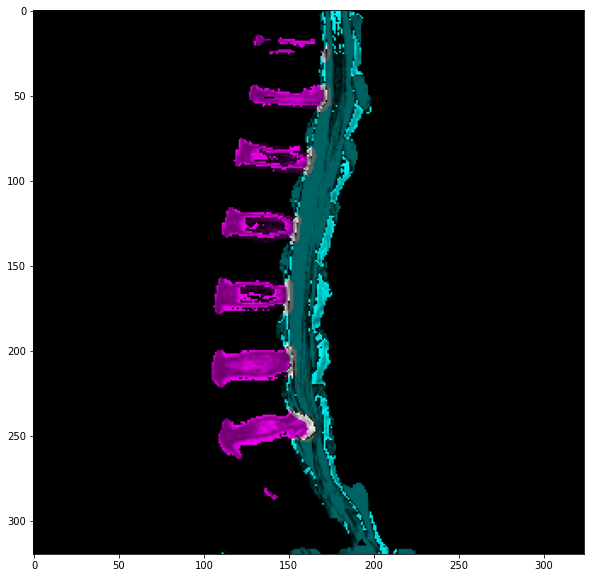

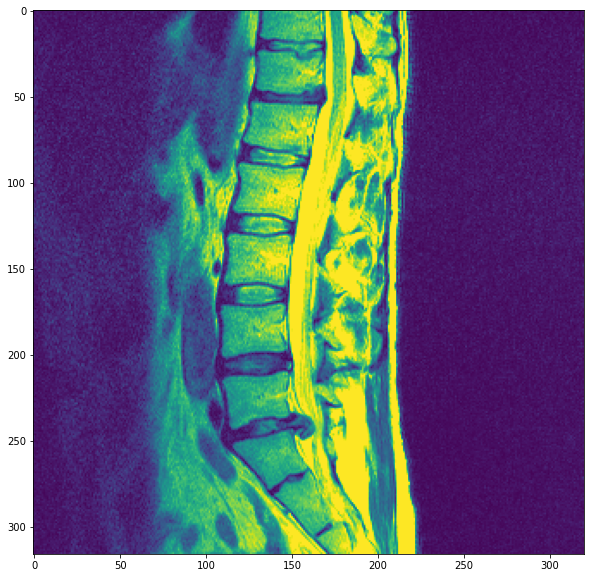

------------------------------------------------------------------------------------------

00126.PNG
torch.Size([1, 2, 240, 256])
(2, 512, 546)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

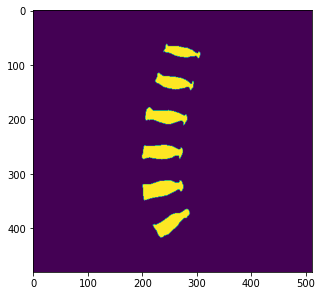

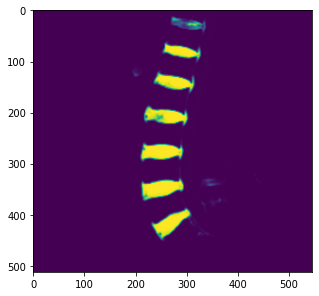

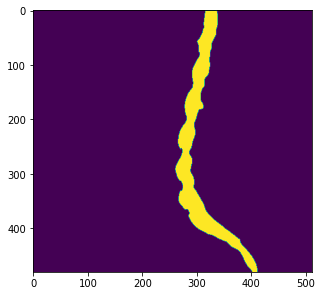

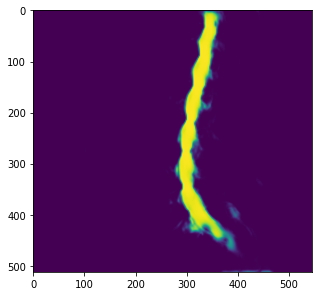

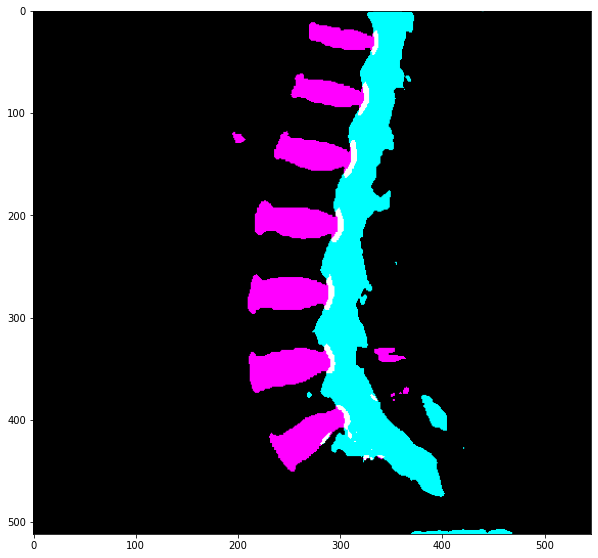

<Figure size 1440x1440 with 0 Axes>

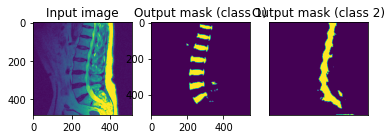

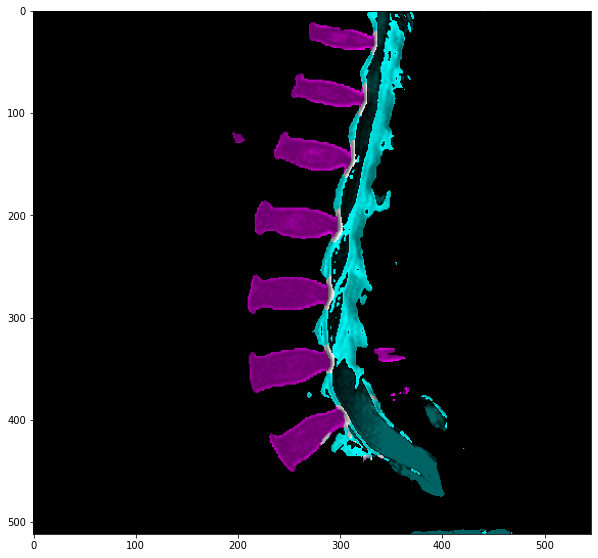

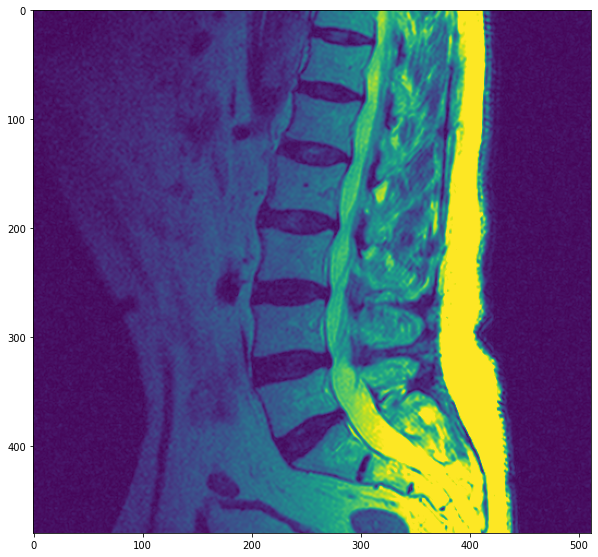

------------------------------------------------------------------------------------------

00234.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

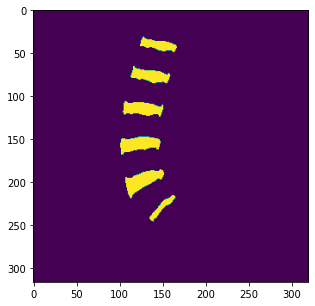

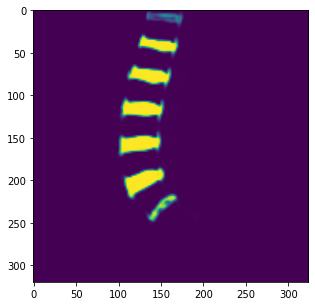

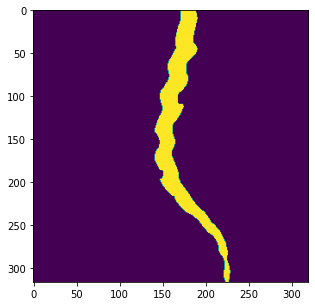

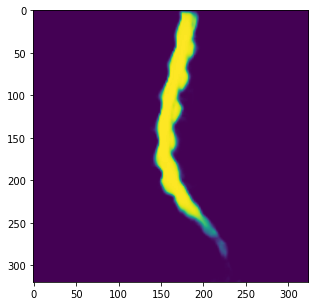

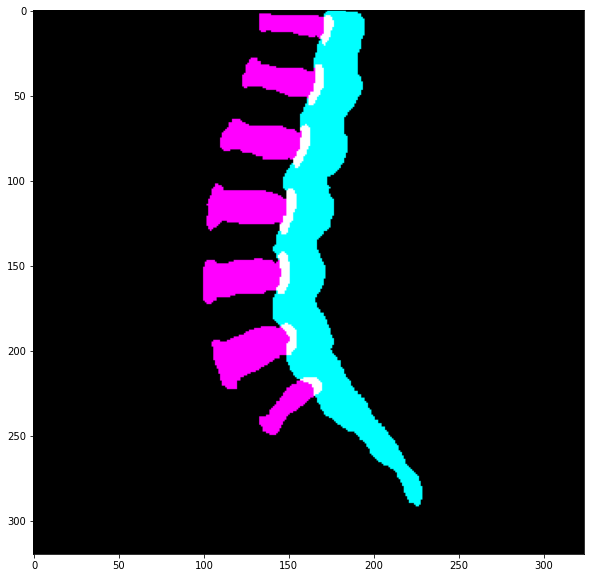

<Figure size 1440x1440 with 0 Axes>

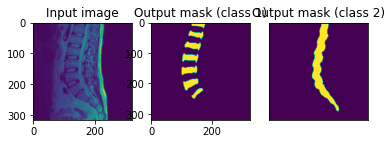

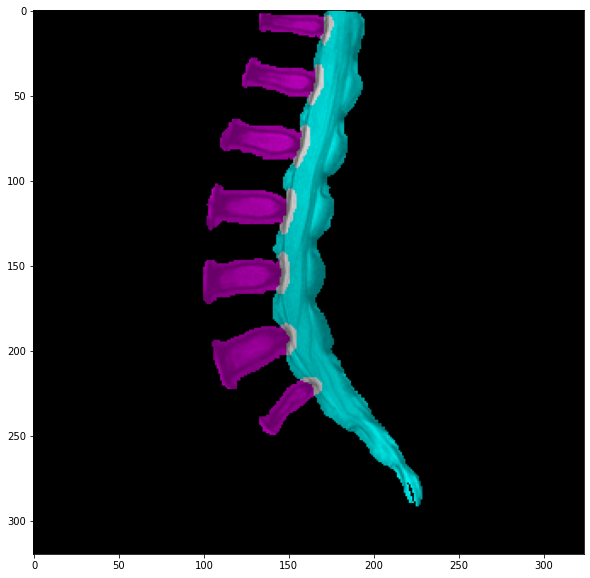

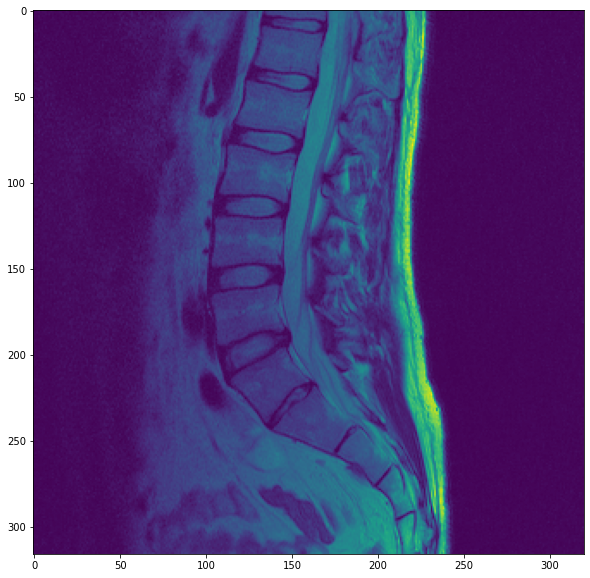

------------------------------------------------------------------------------------------

00212.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

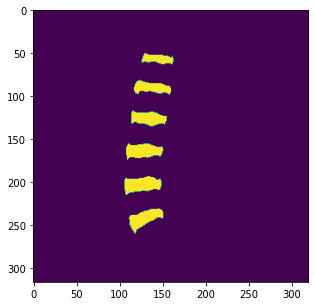

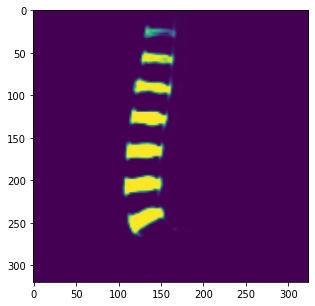

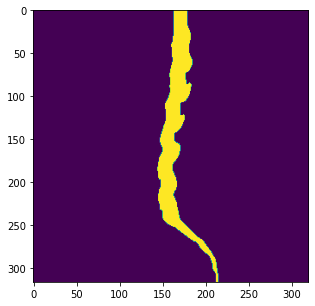

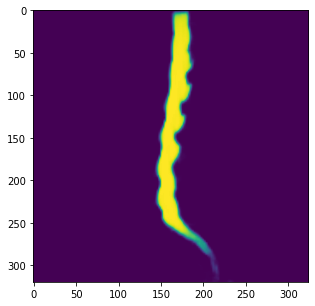

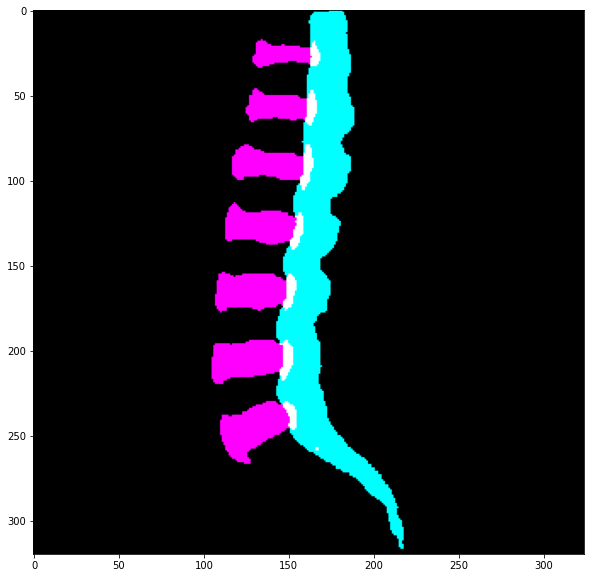

<Figure size 1440x1440 with 0 Axes>

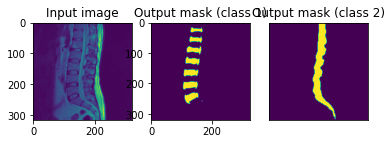

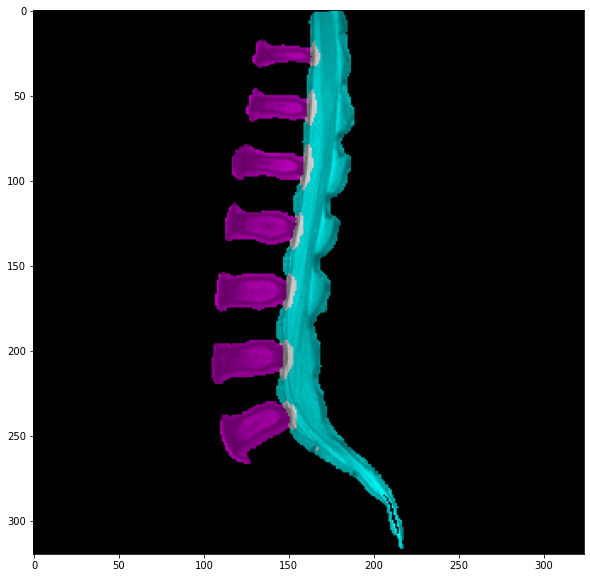

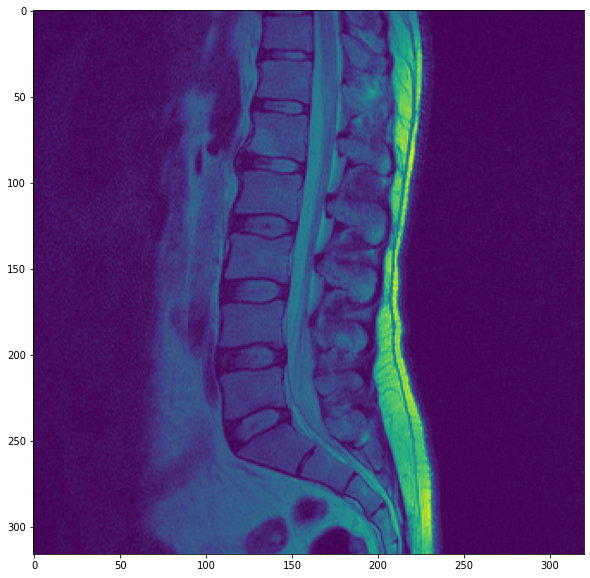

------------------------------------------------------------------------------------------

00046.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

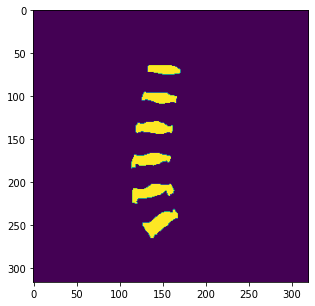

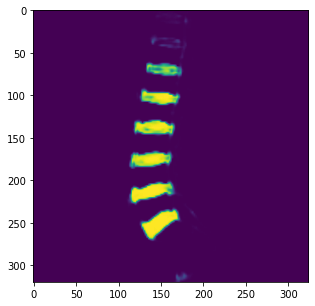

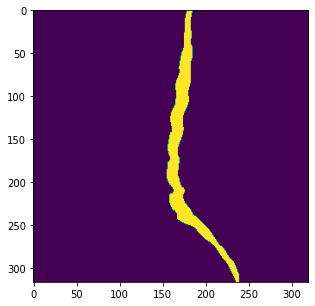

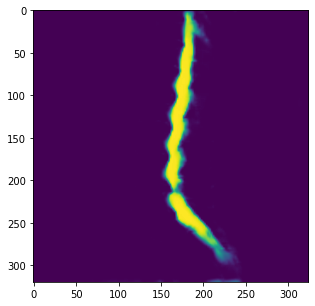

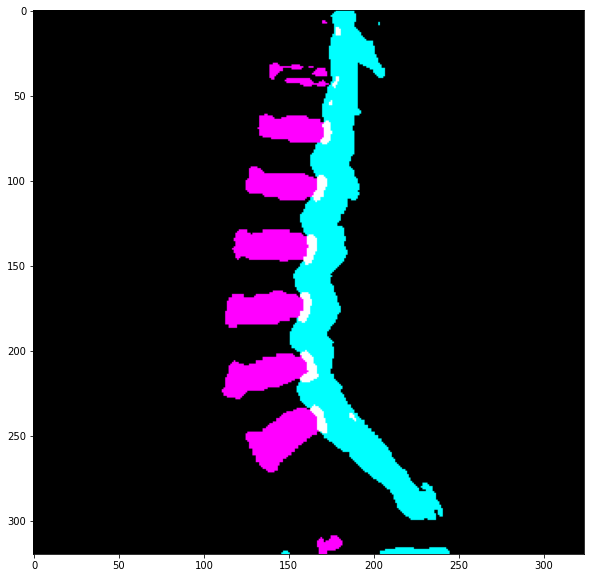

<Figure size 1440x1440 with 0 Axes>

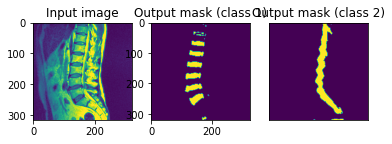

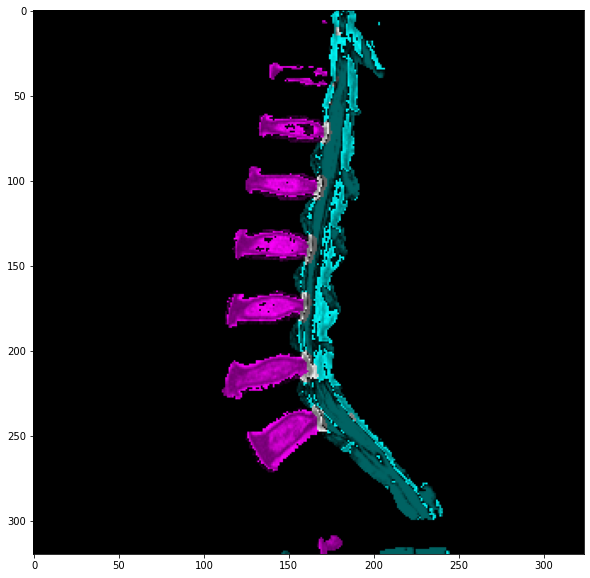

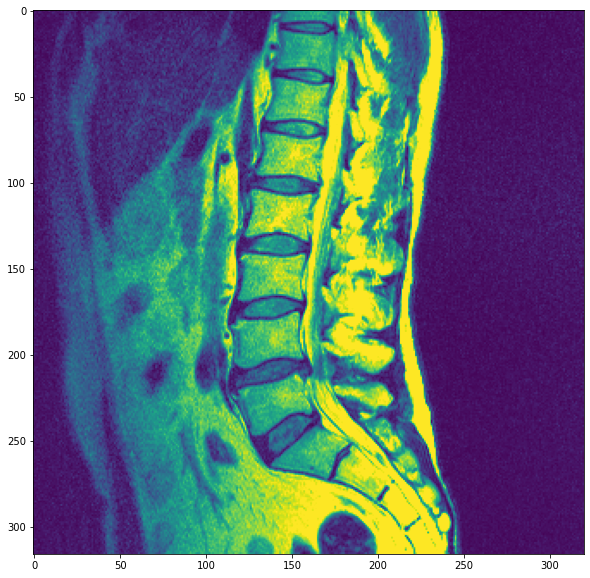

------------------------------------------------------------------------------------------

00226.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

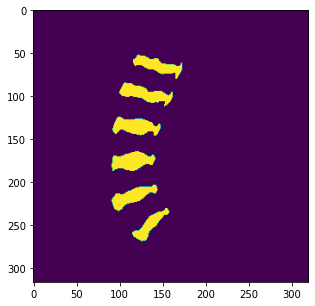

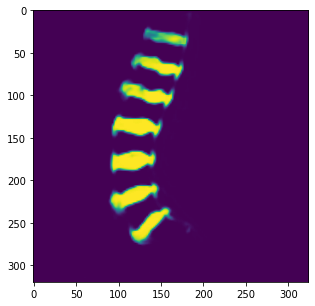

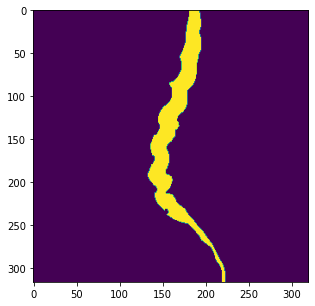

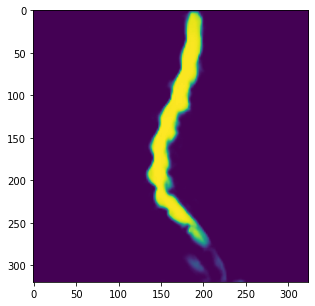

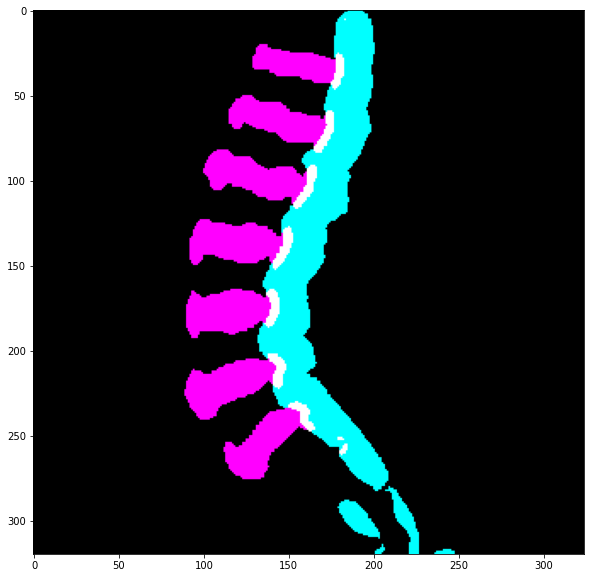

<Figure size 1440x1440 with 0 Axes>

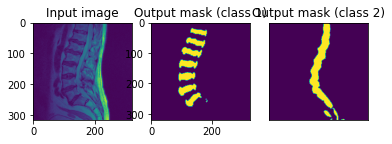

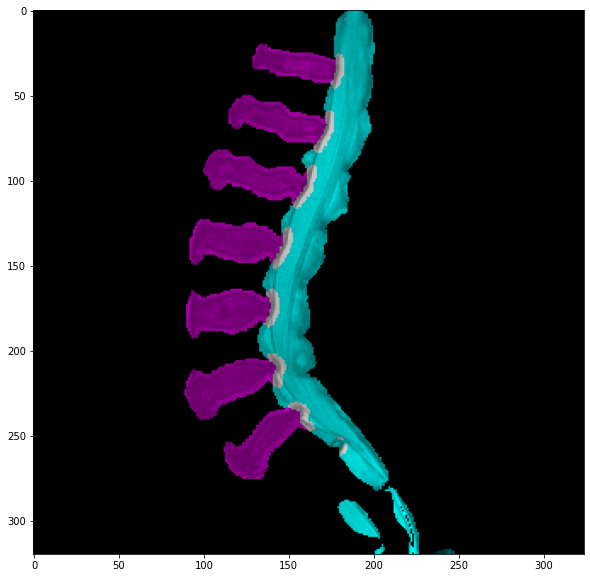

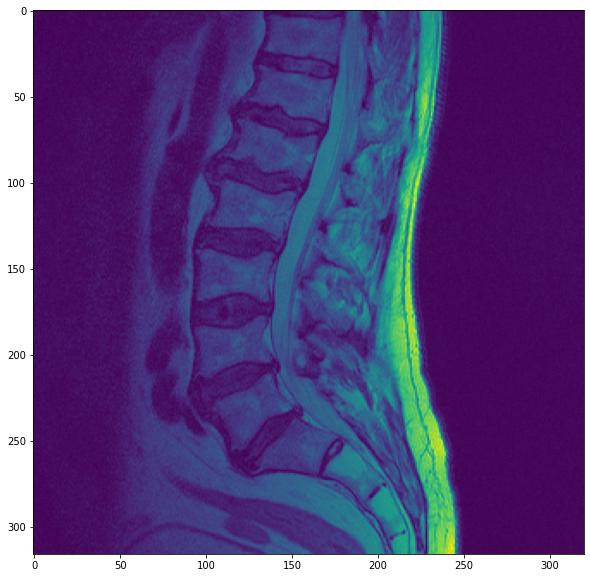

------------------------------------------------------------------------------------------

00208.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

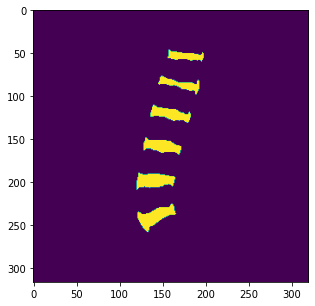

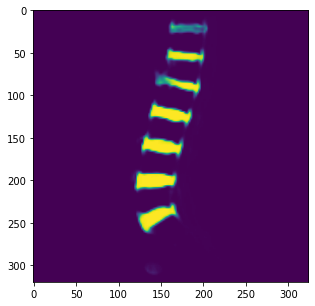

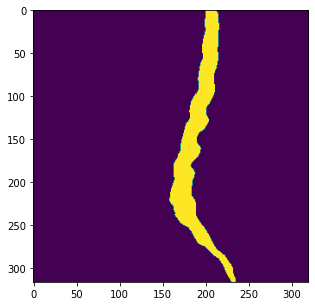

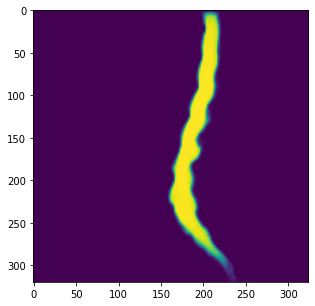

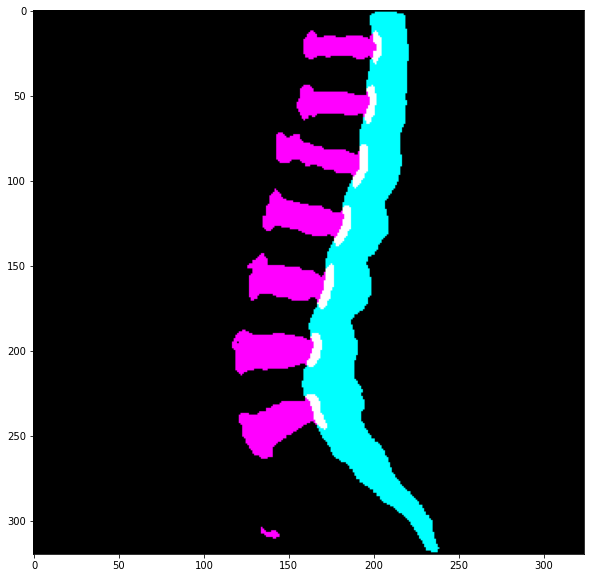

<Figure size 1440x1440 with 0 Axes>

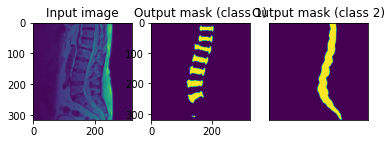

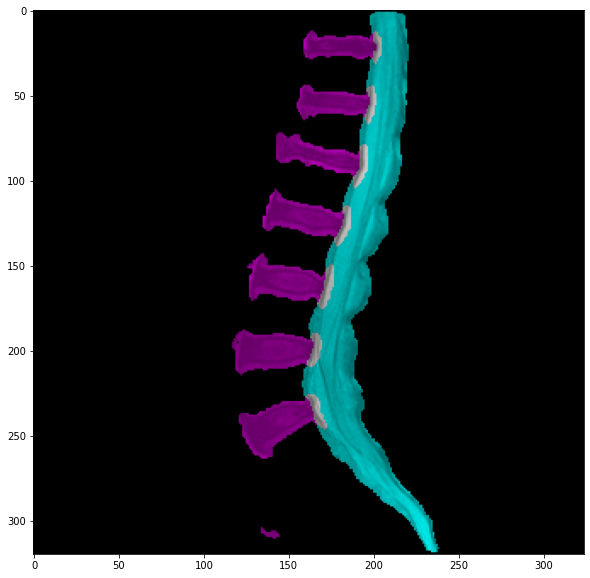

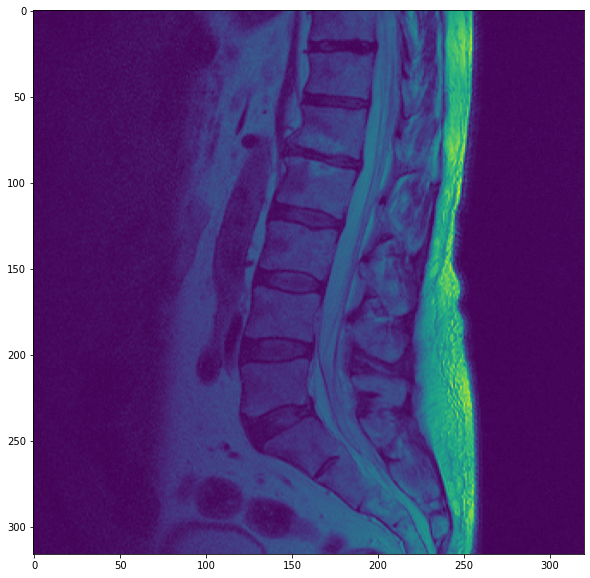

------------------------------------------------------------------------------------------

00186.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

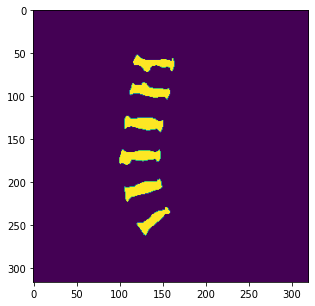

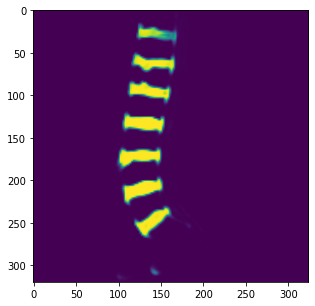

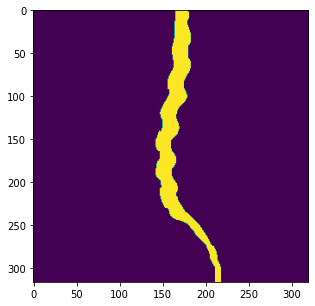

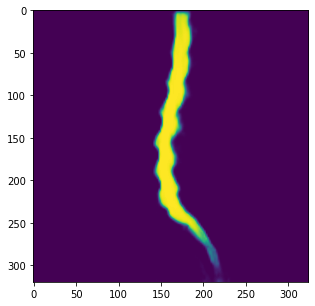

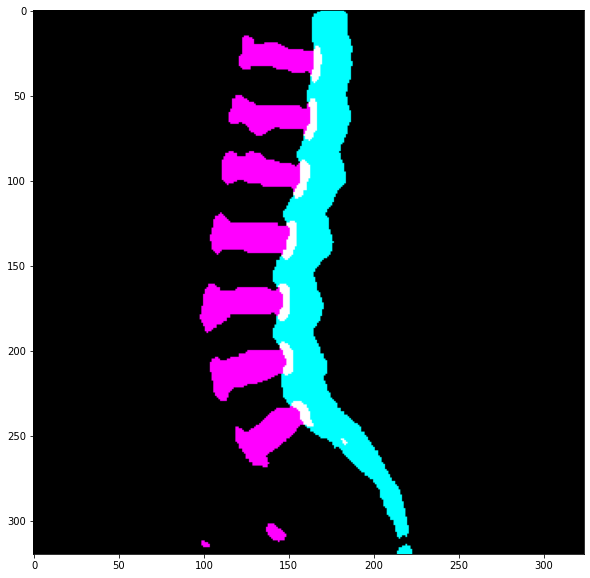

<Figure size 1440x1440 with 0 Axes>

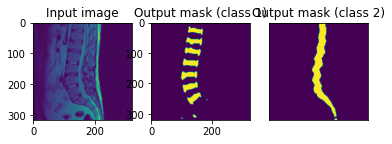

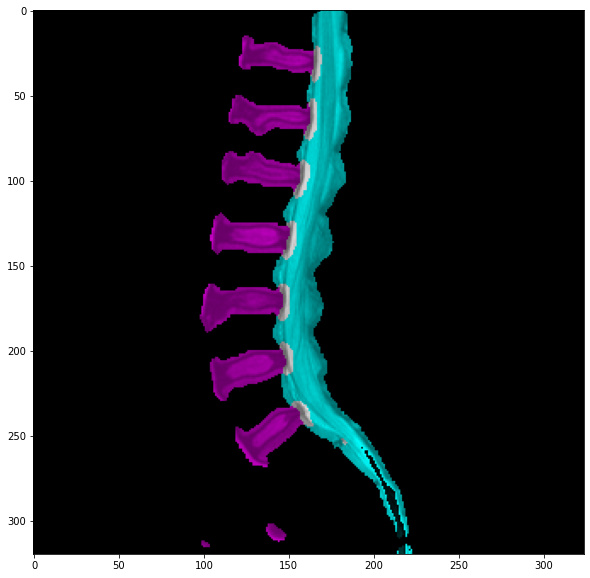

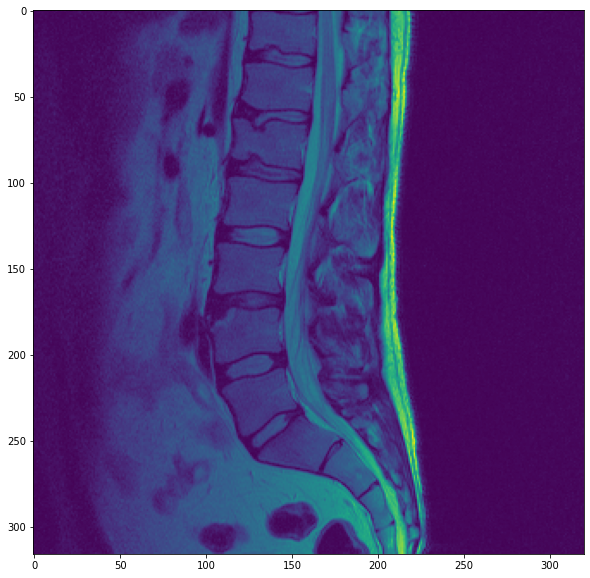

------------------------------------------------------------------------------------------

00193.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

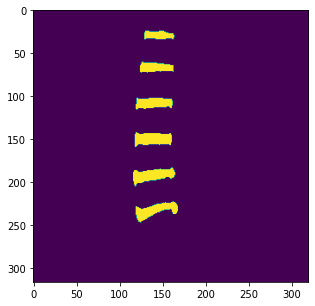

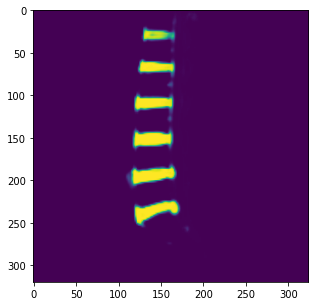

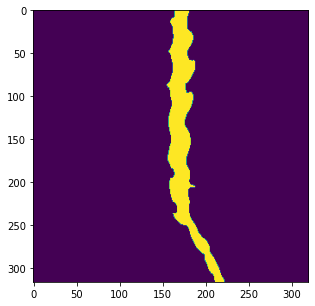

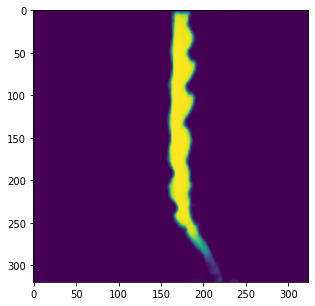

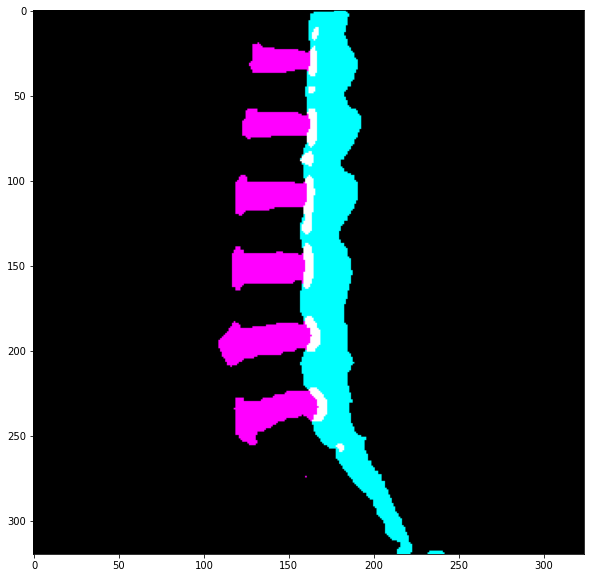

<Figure size 1440x1440 with 0 Axes>

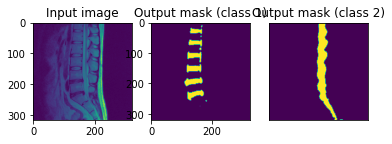

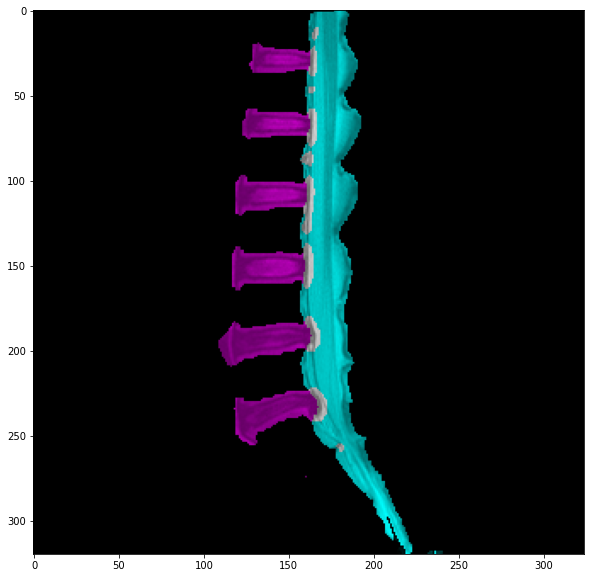

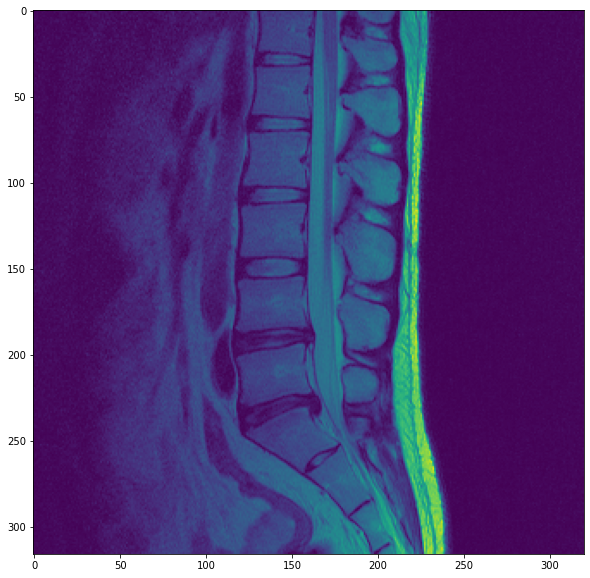

------------------------------------------------------------------------------------------

00046.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

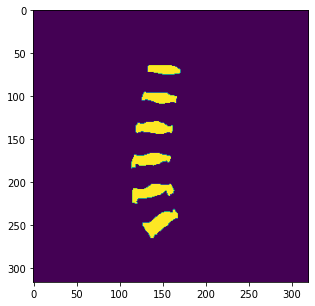

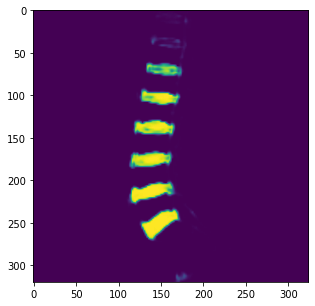

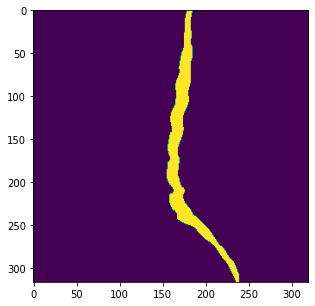

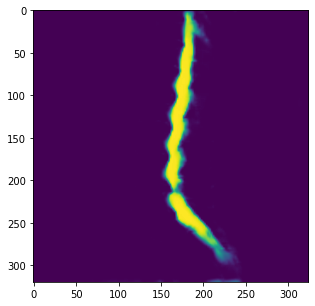

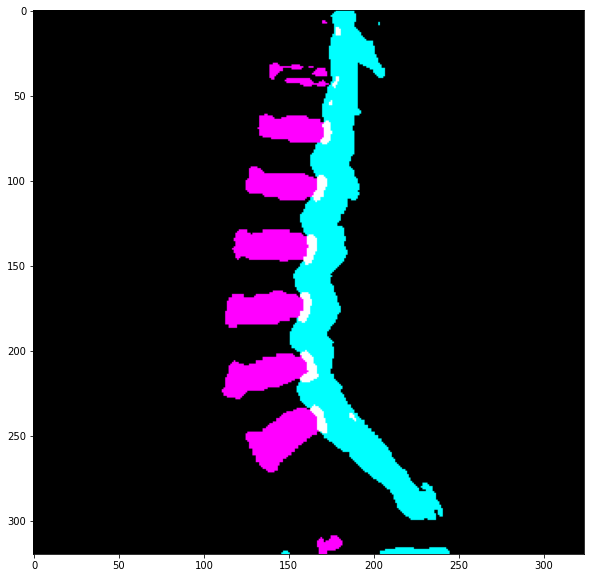

<Figure size 1440x1440 with 0 Axes>

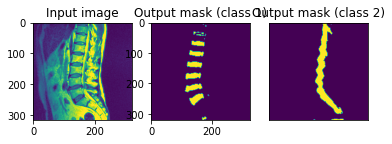

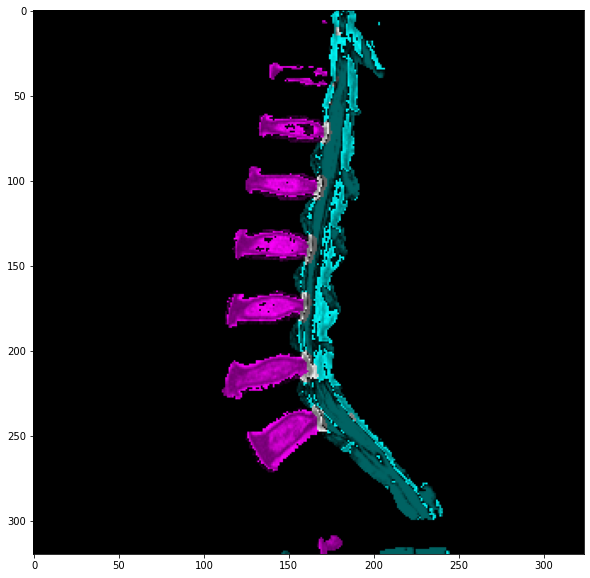

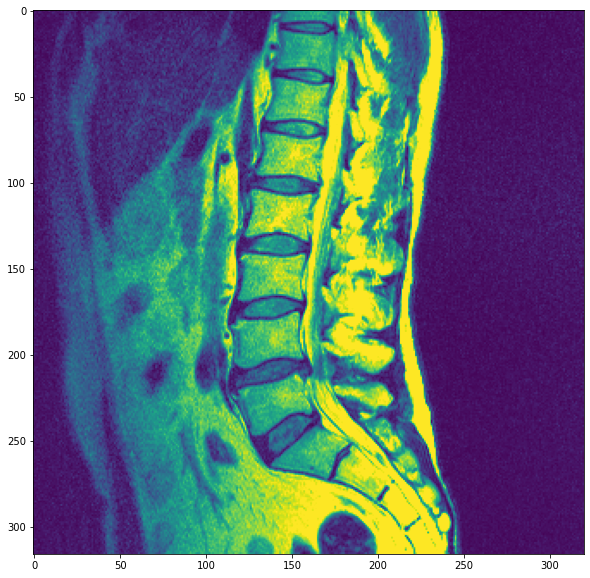

------------------------------------------------------------------------------------------

00074.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

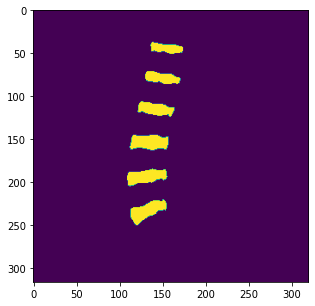

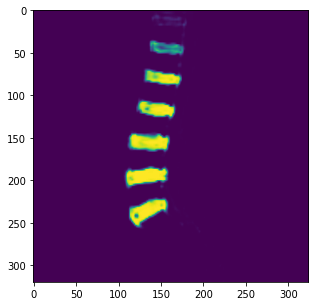

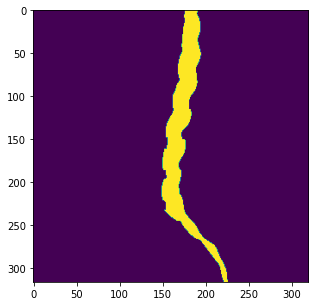

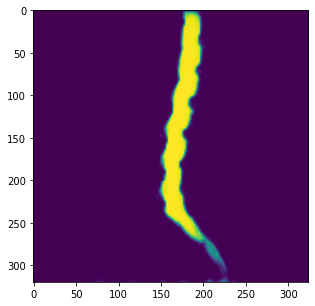

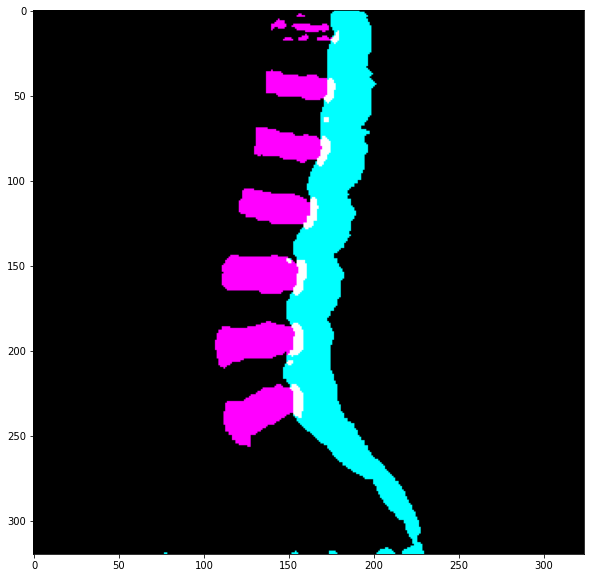

<Figure size 1440x1440 with 0 Axes>

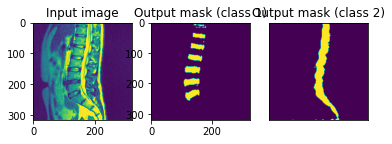

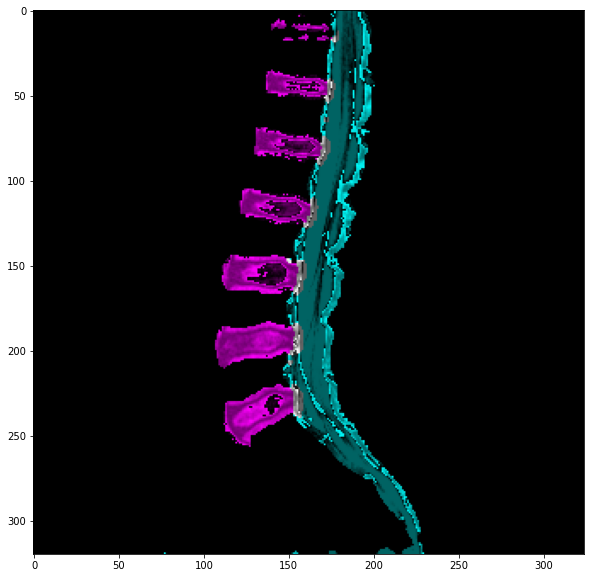

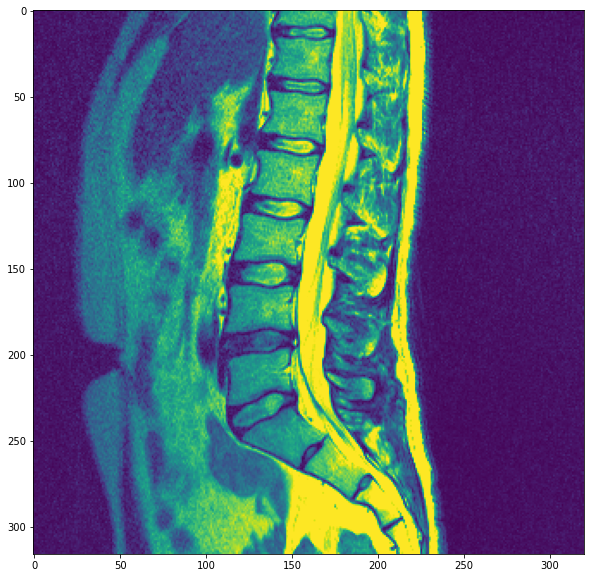

------------------------------------------------------------------------------------------

00042.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

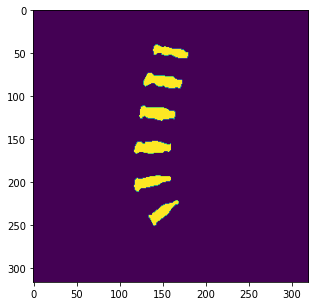

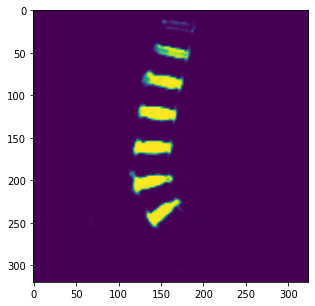

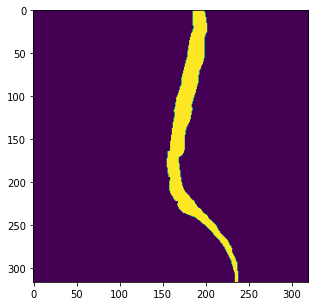

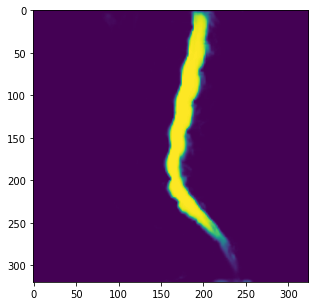

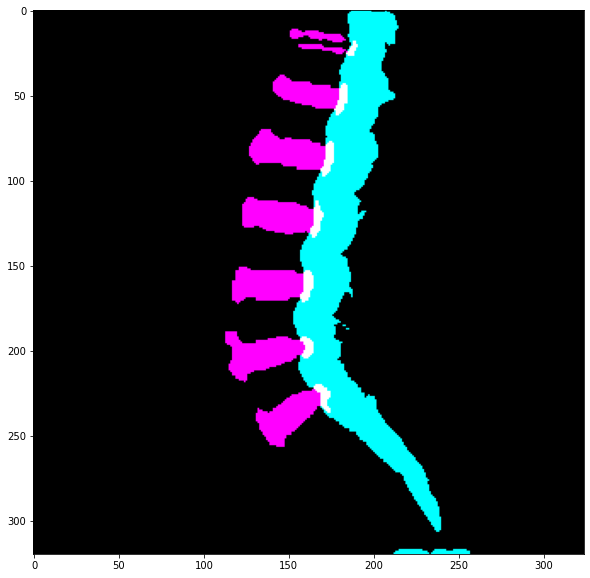

<Figure size 1440x1440 with 0 Axes>

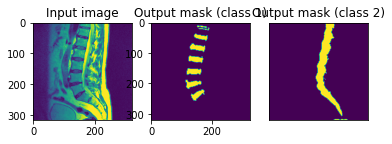

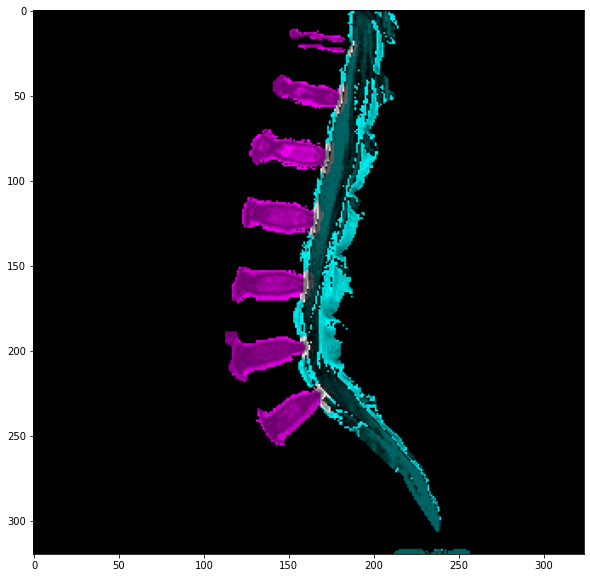

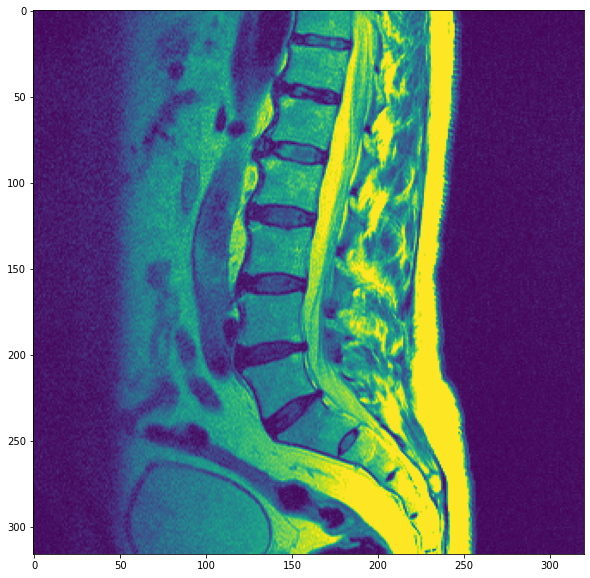

------------------------------------------------------------------------------------------

00040.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

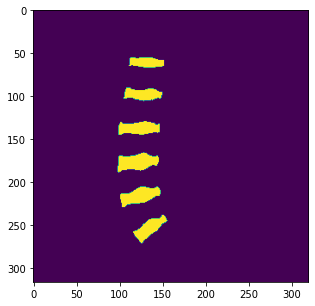

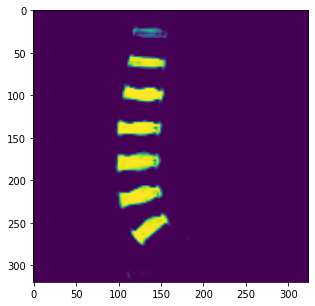

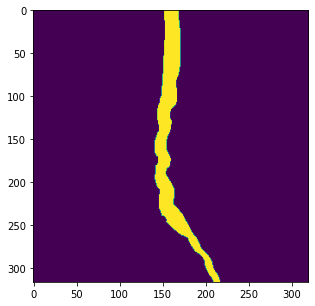

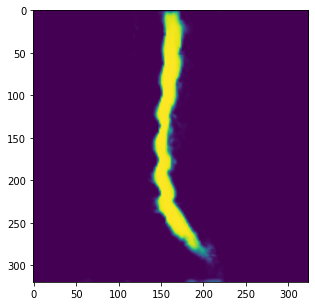

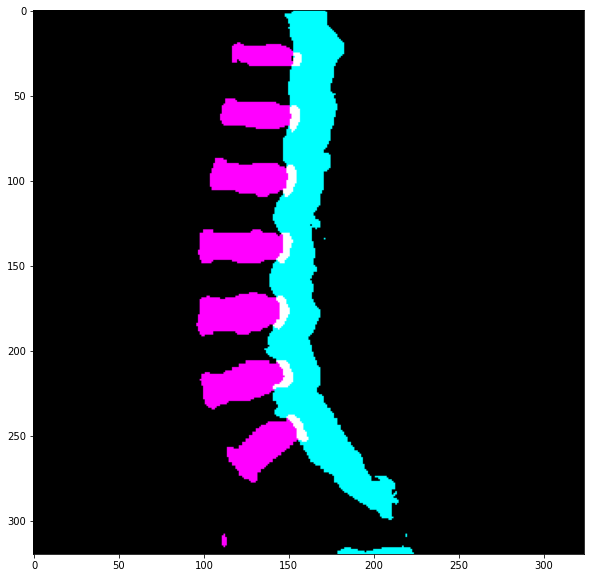

<Figure size 1440x1440 with 0 Axes>

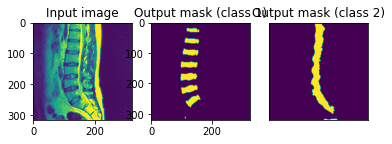

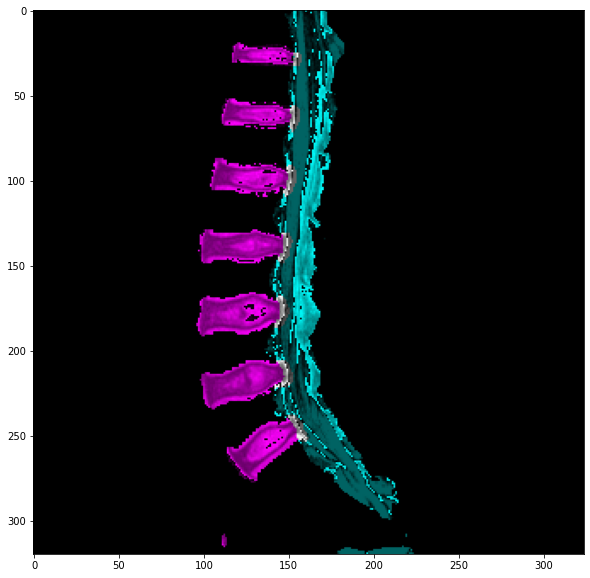

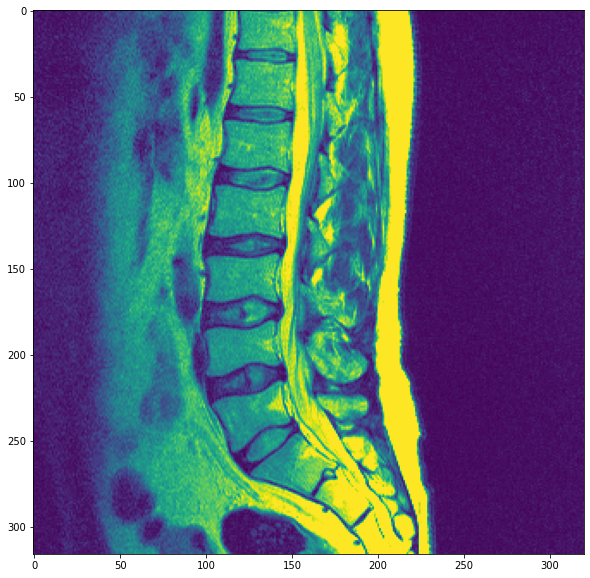

------------------------------------------------------------------------------------------

00205.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

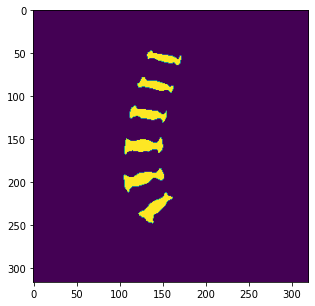

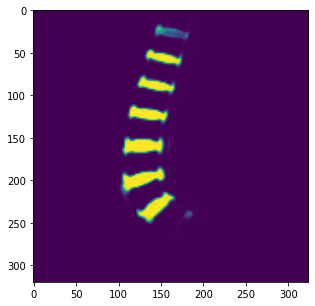

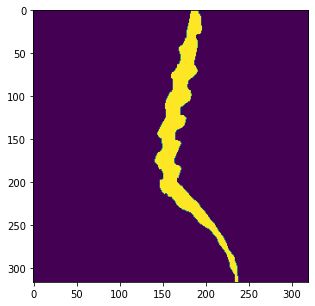

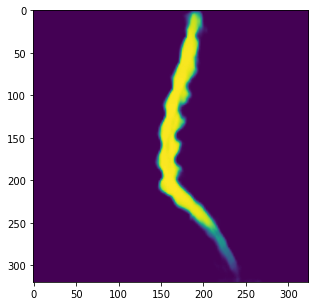

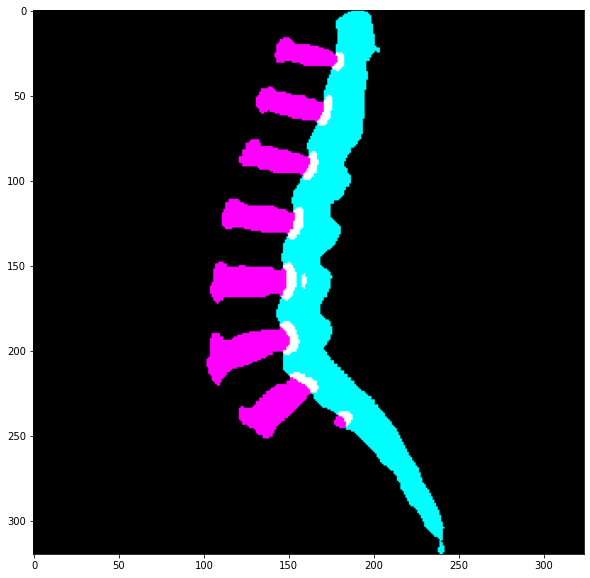

<Figure size 1440x1440 with 0 Axes>

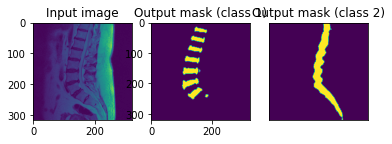

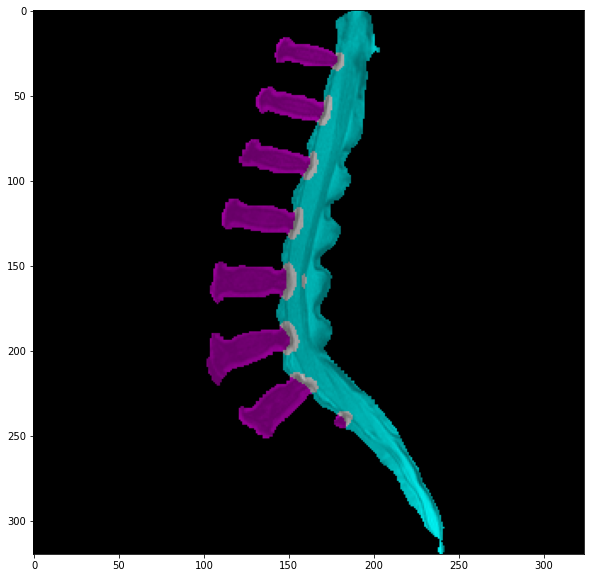

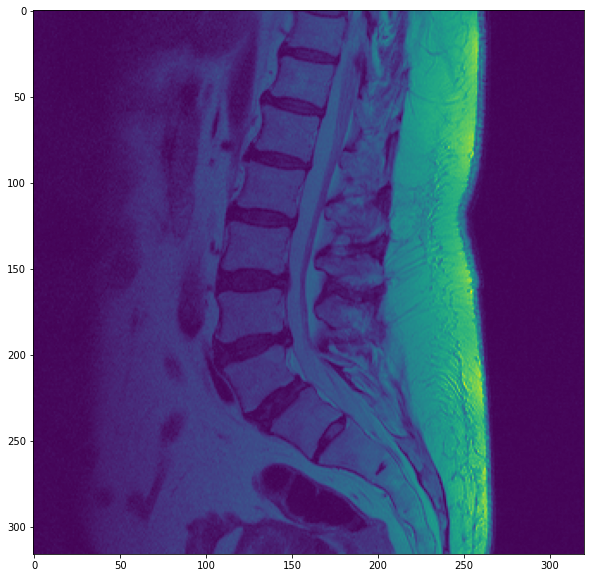

------------------------------------------------------------------------------------------

00147.PNG
torch.Size([1, 2, 160, 160])
(2, 320, 320)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

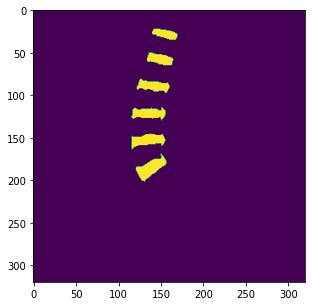

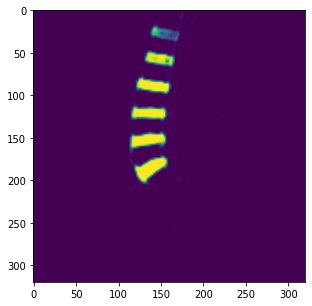

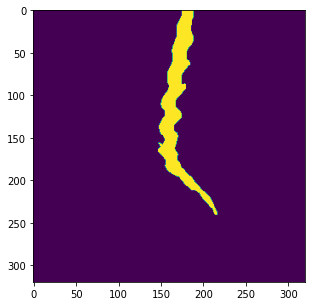

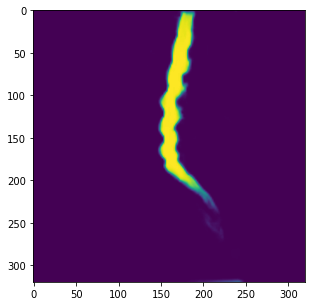

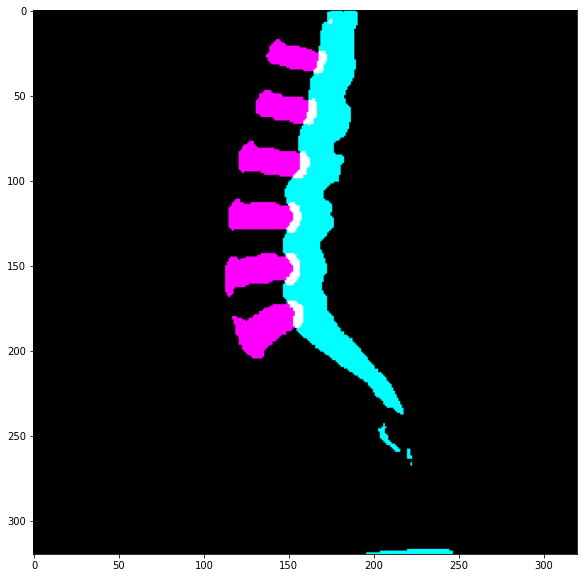

<Figure size 1440x1440 with 0 Axes>

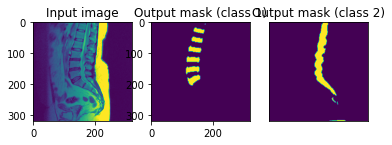

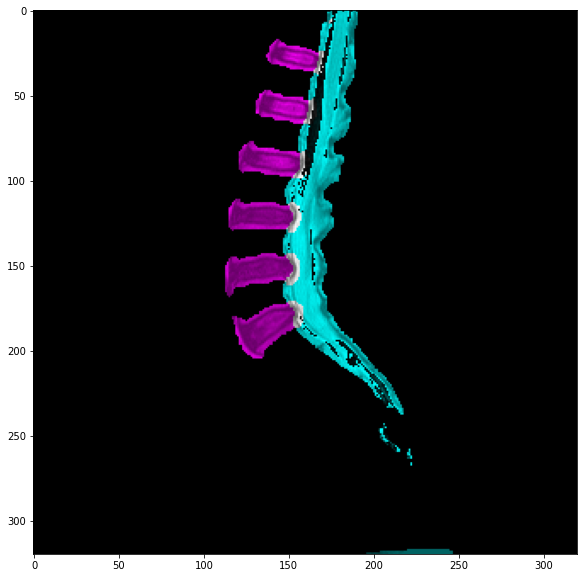

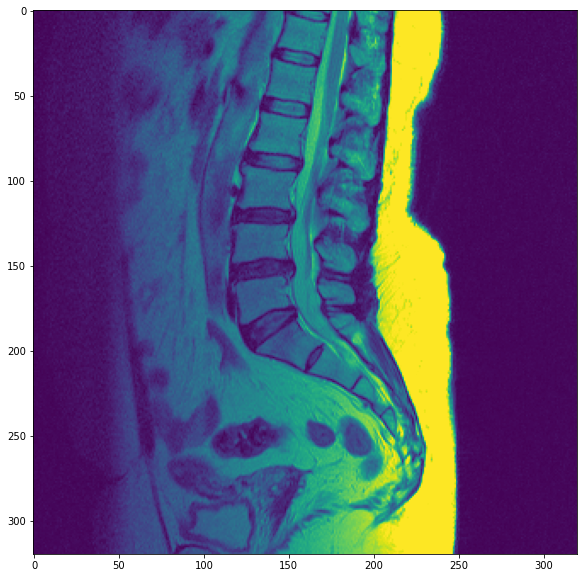

------------------------------------------------------------------------------------------

00041.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

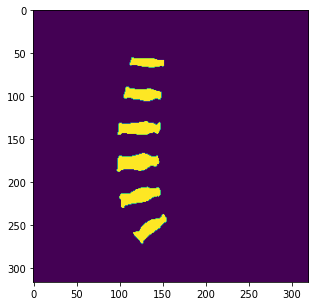

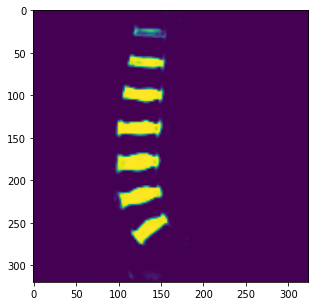

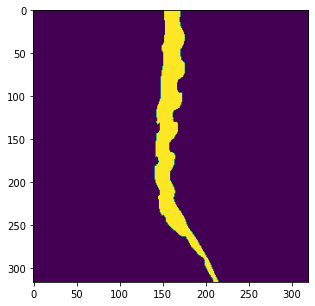

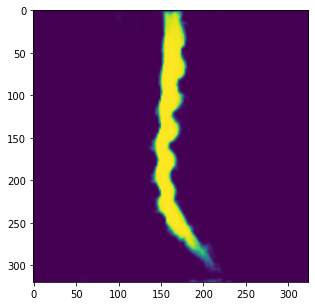

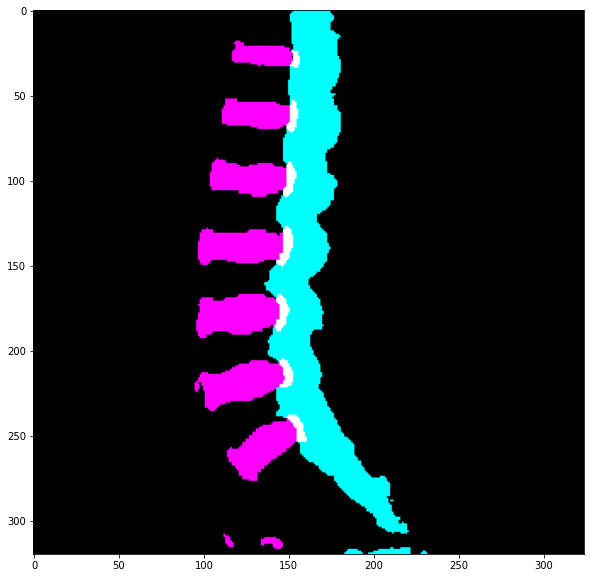

<Figure size 1440x1440 with 0 Axes>

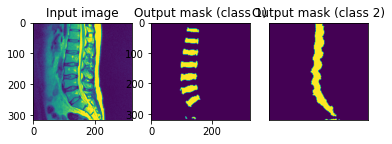

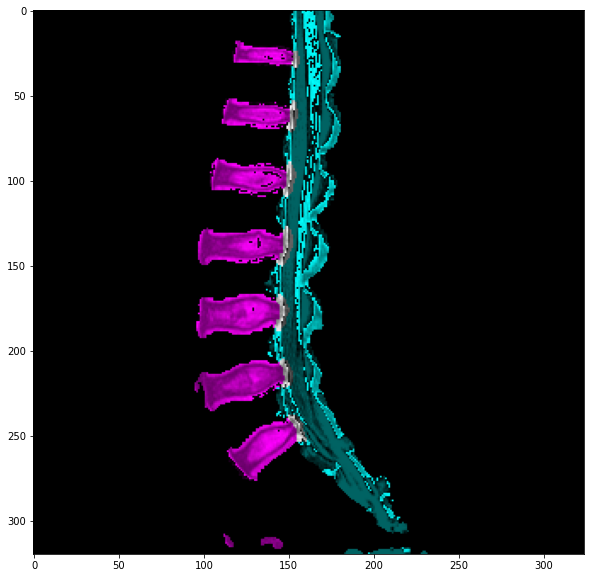

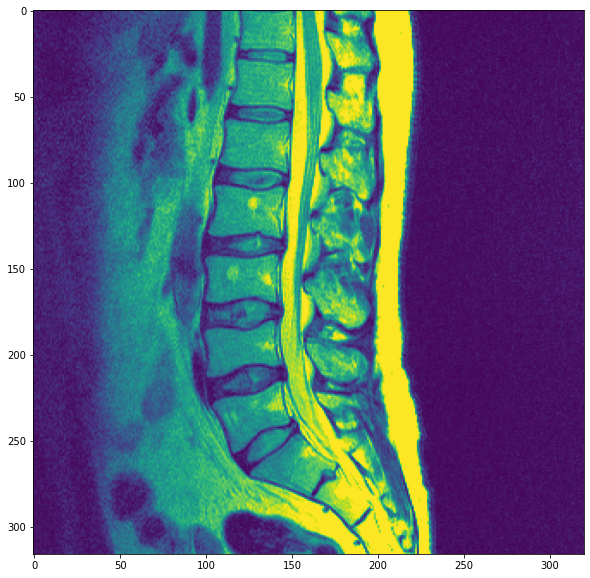

------------------------------------------------------------------------------------------

00344.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

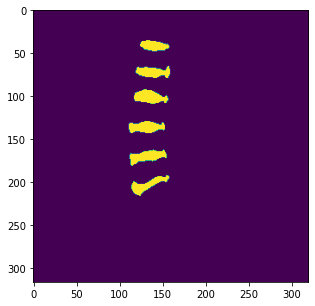

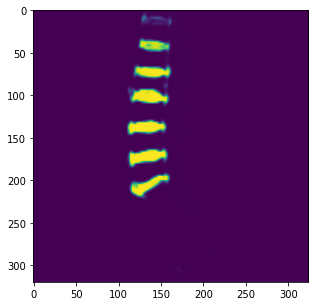

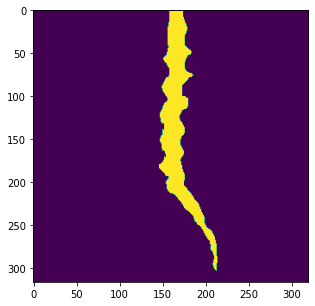

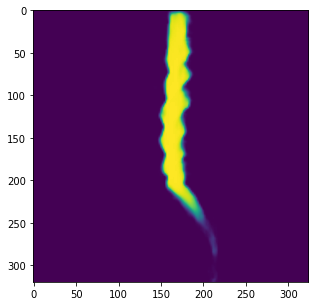

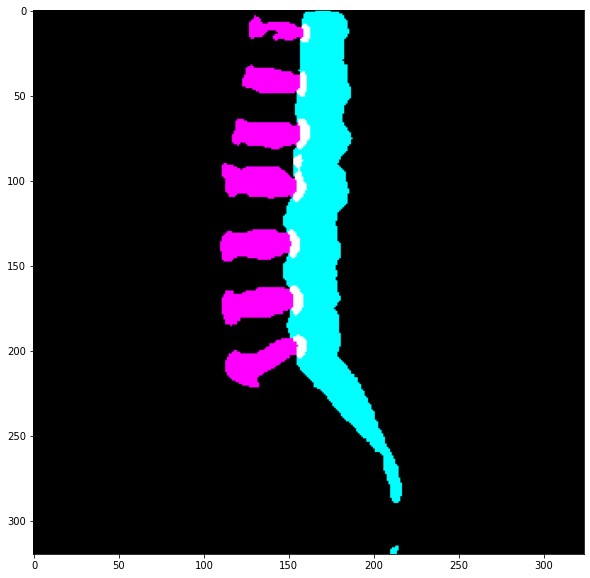

<Figure size 1440x1440 with 0 Axes>

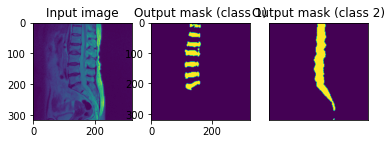

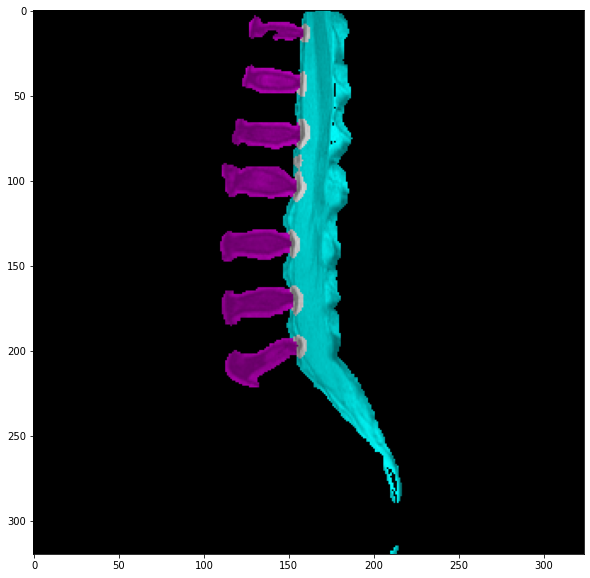

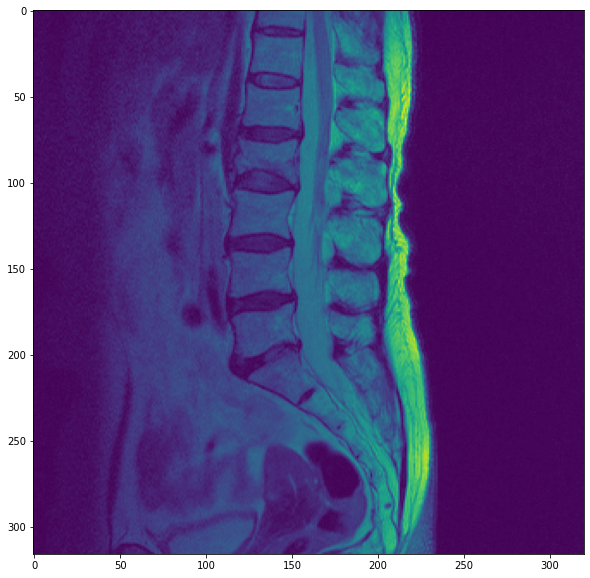

------------------------------------------------------------------------------------------

00247.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

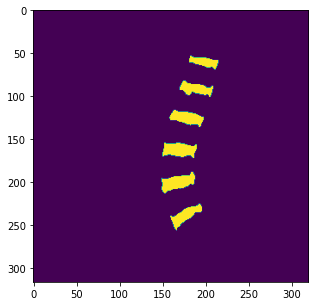

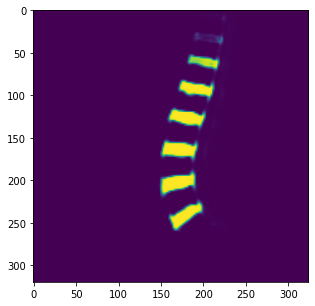

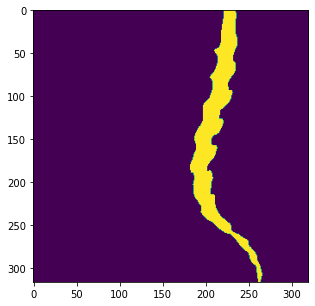

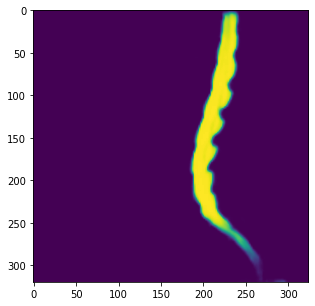

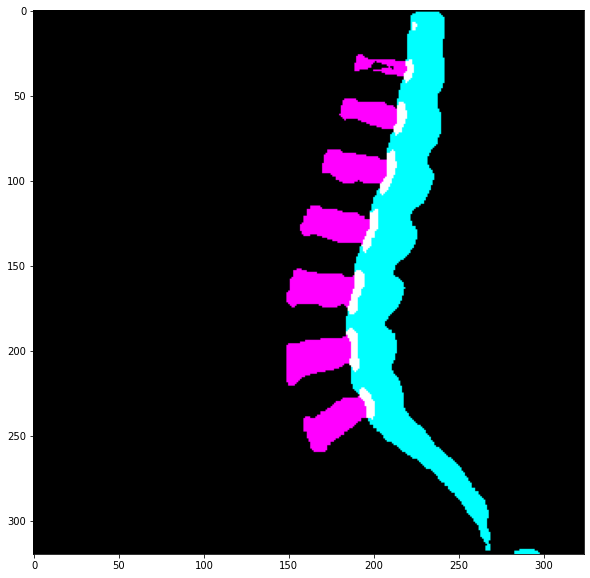

<Figure size 1440x1440 with 0 Axes>

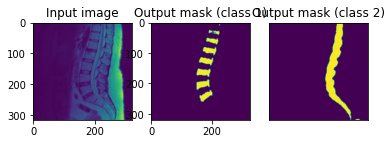

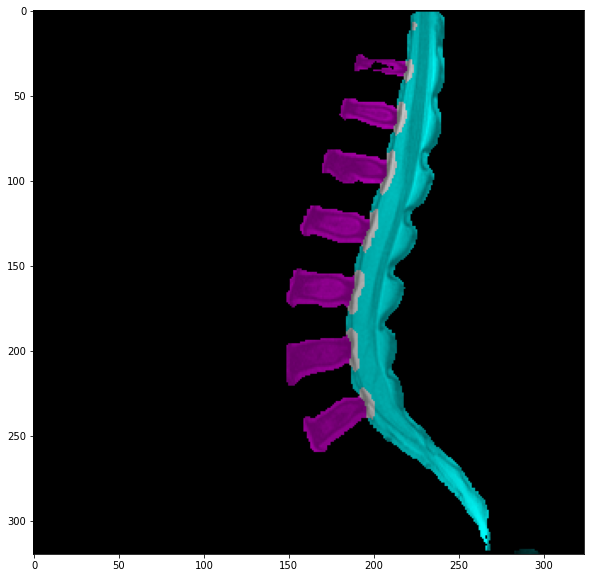

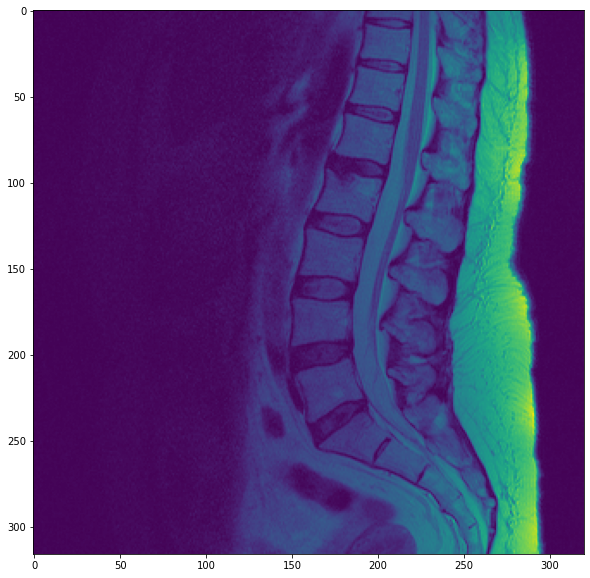

------------------------------------------------------------------------------------------

00266.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

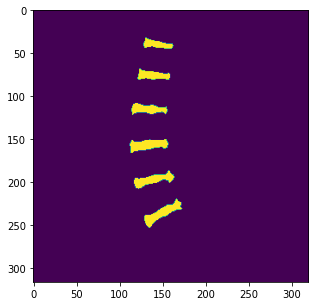

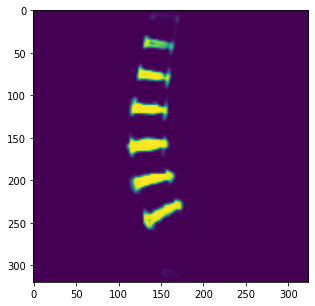

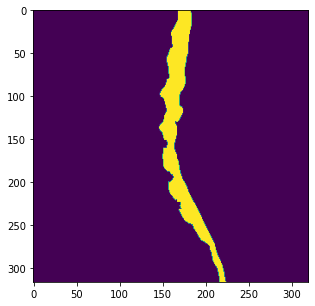

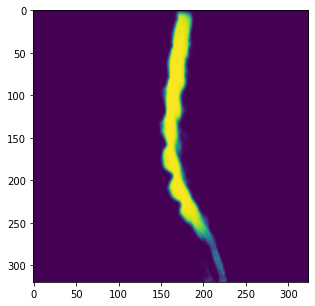

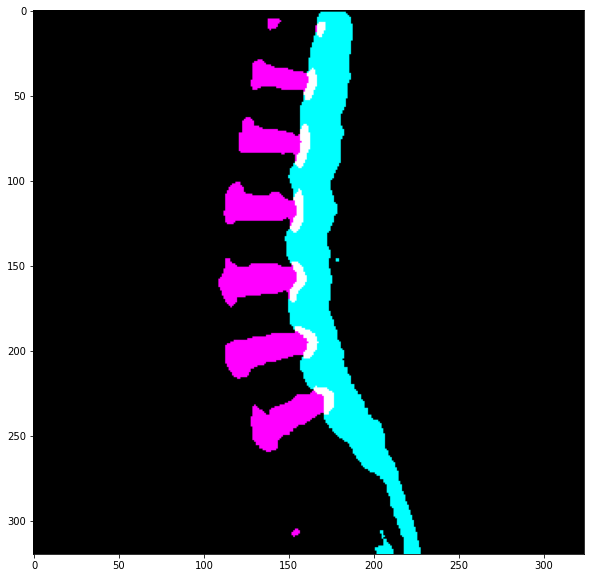

<Figure size 1440x1440 with 0 Axes>

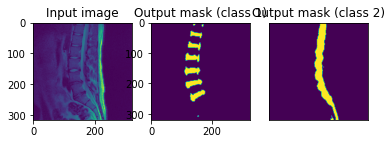

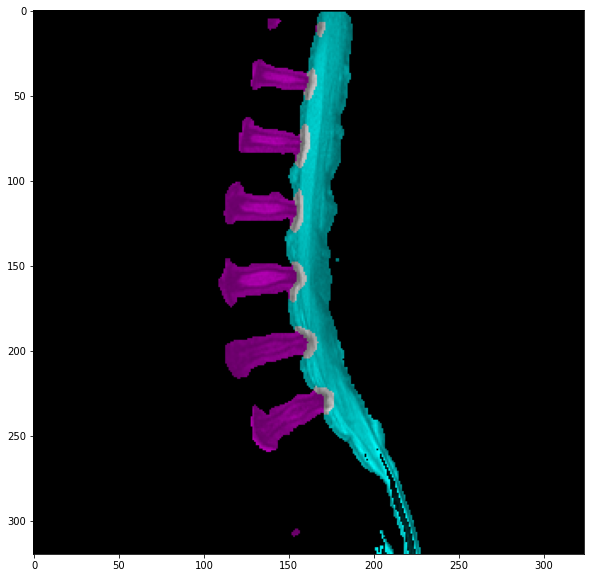

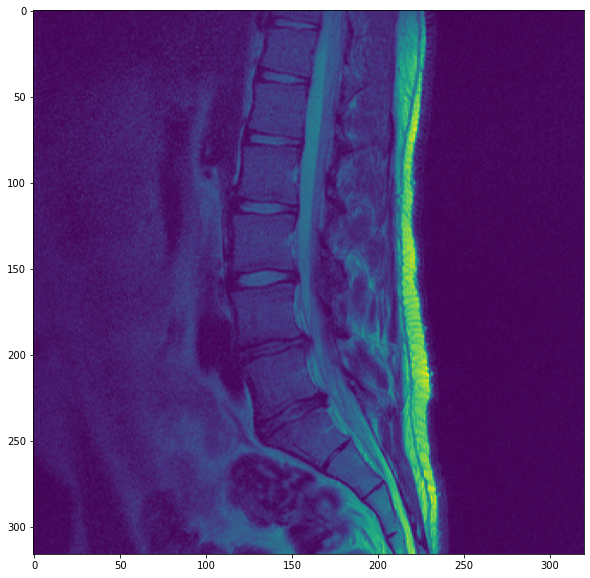

------------------------------------------------------------------------------------------

00093.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

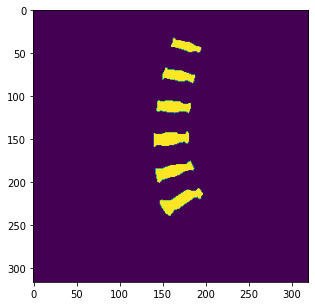

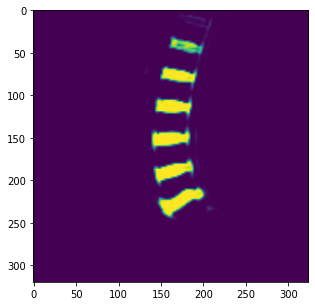

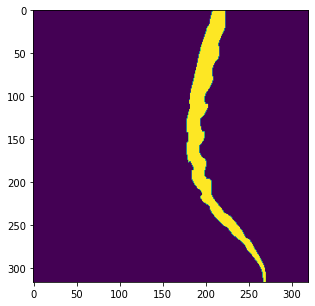

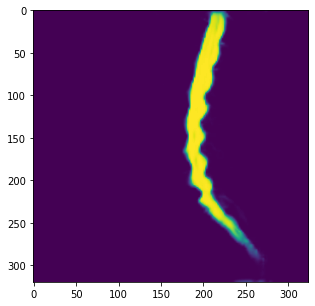

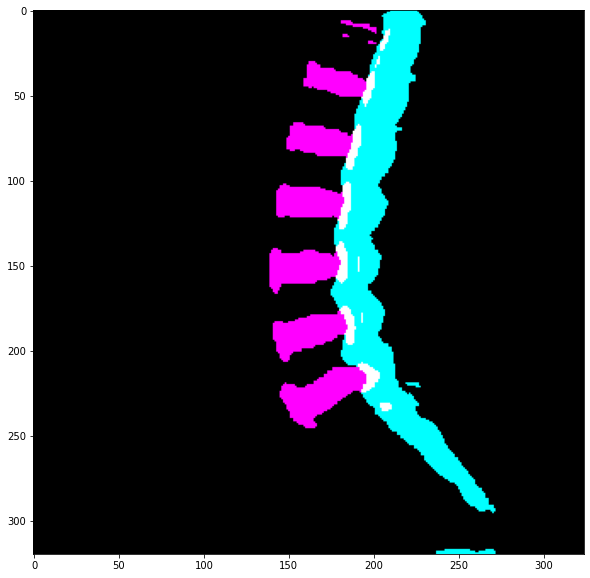

<Figure size 1440x1440 with 0 Axes>

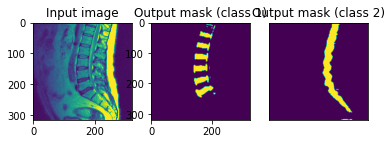

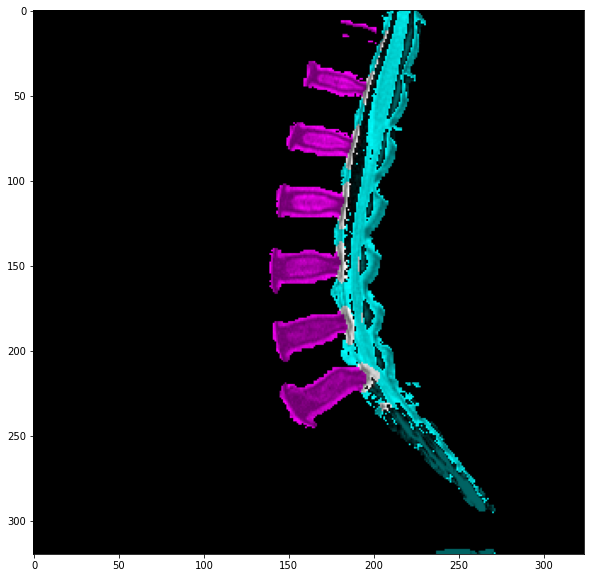

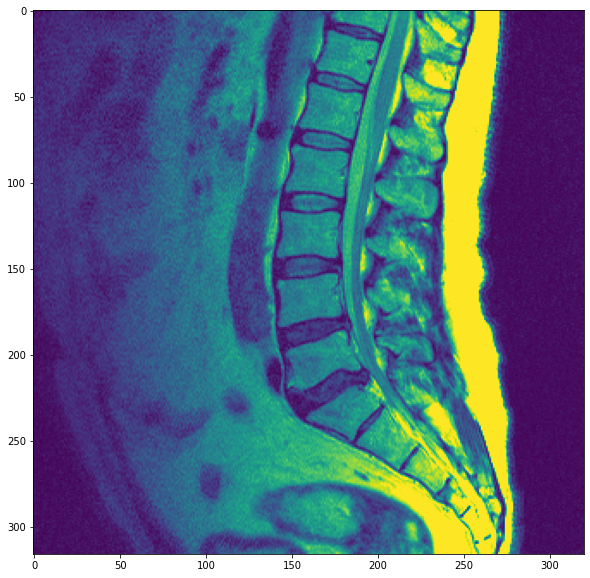

------------------------------------------------------------------------------------------

00016.PNG
torch.Size([1, 2, 240, 256])
(2, 512, 546)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

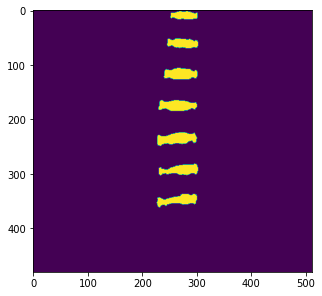

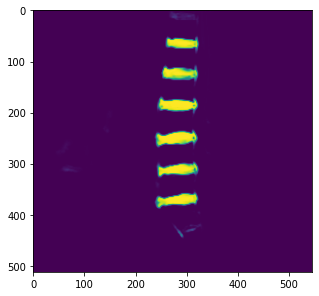

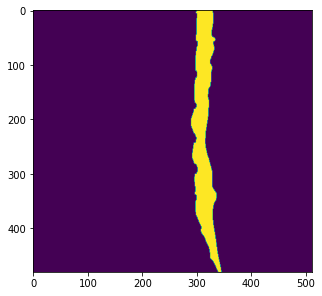

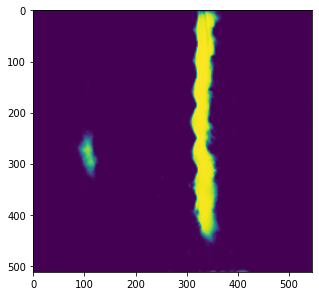

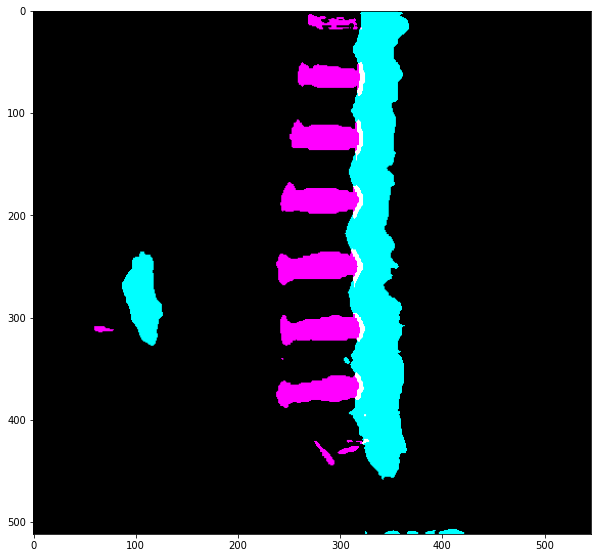

<Figure size 1440x1440 with 0 Axes>

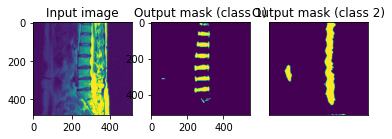

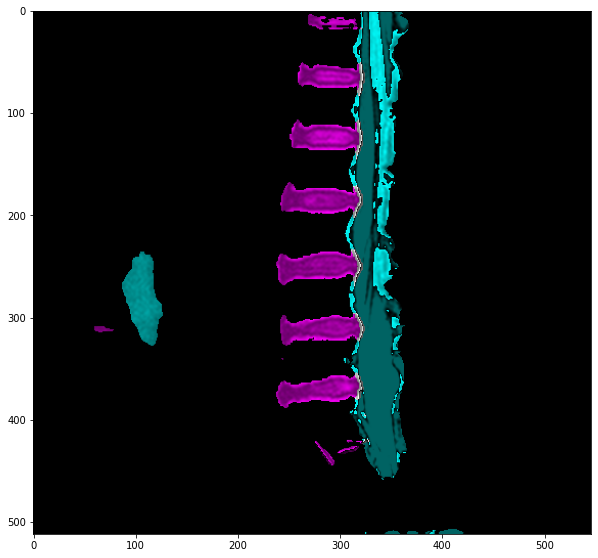

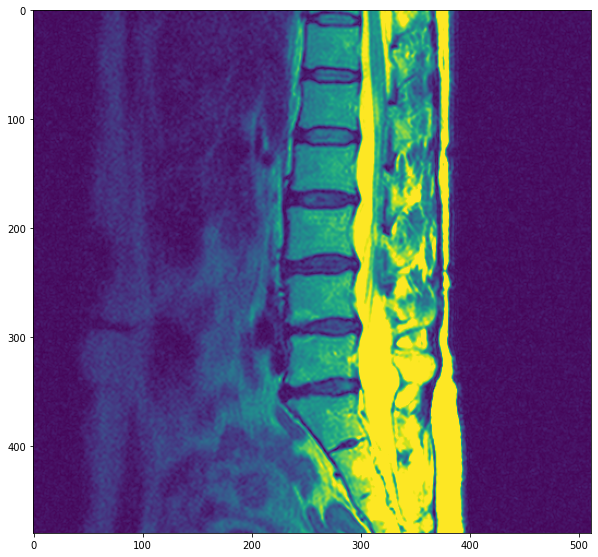

------------------------------------------------------------------------------------------

00157.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

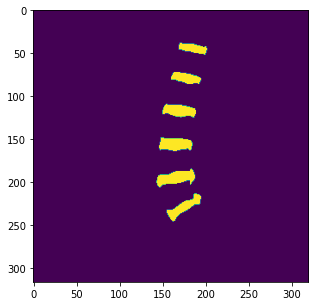

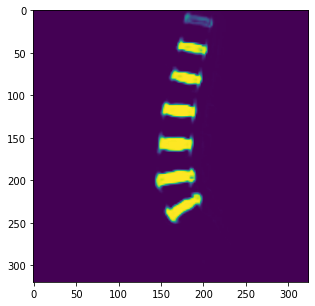

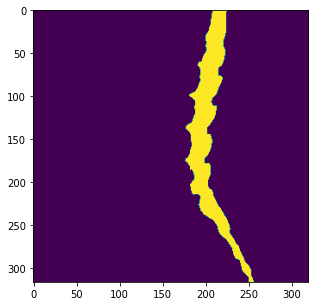

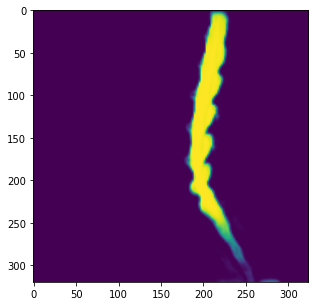

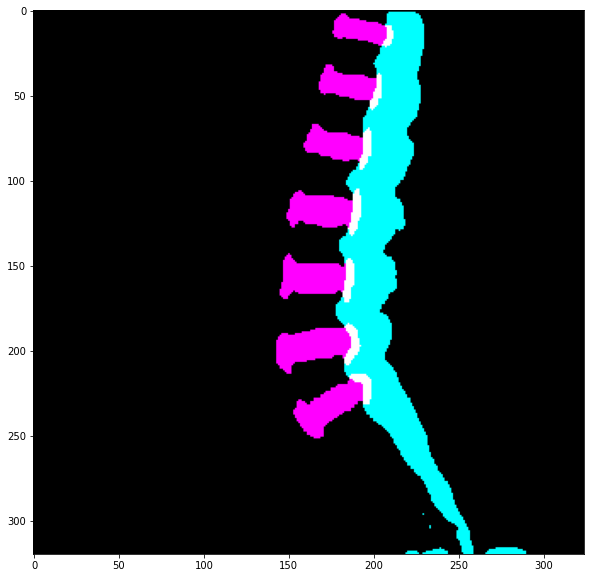

<Figure size 1440x1440 with 0 Axes>

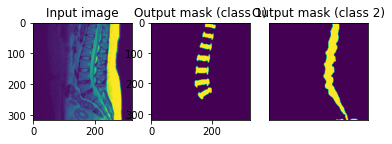

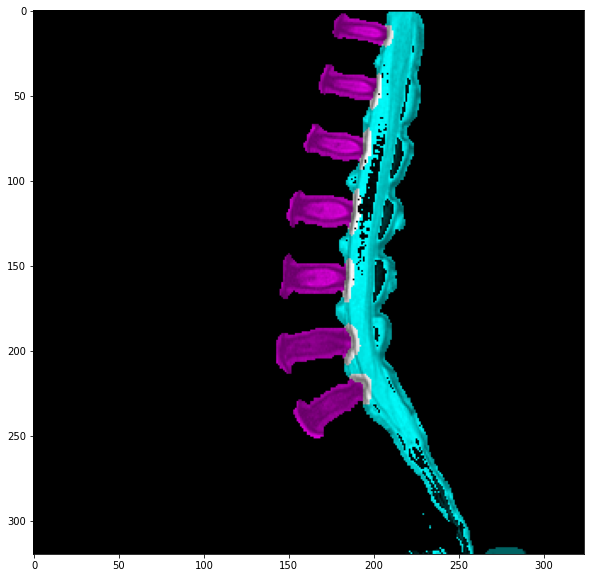

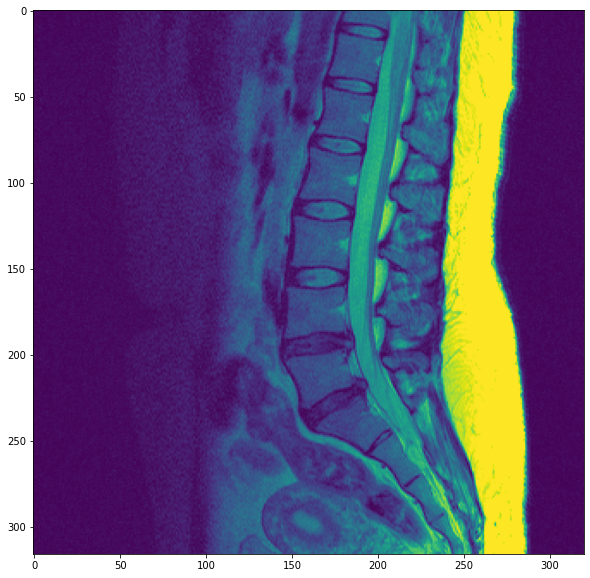

------------------------------------------------------------------------------------------

00333.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

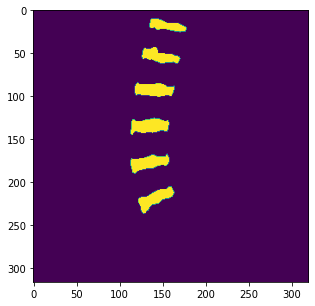

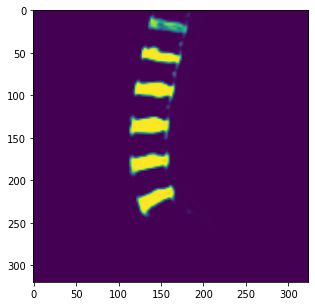

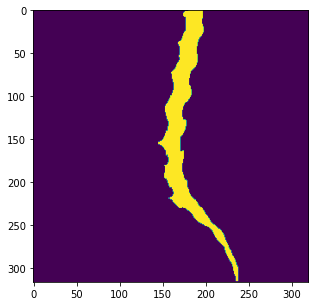

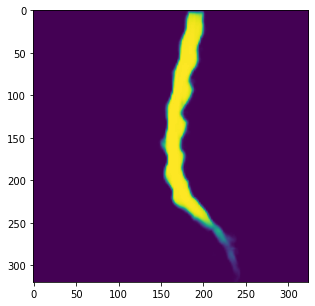

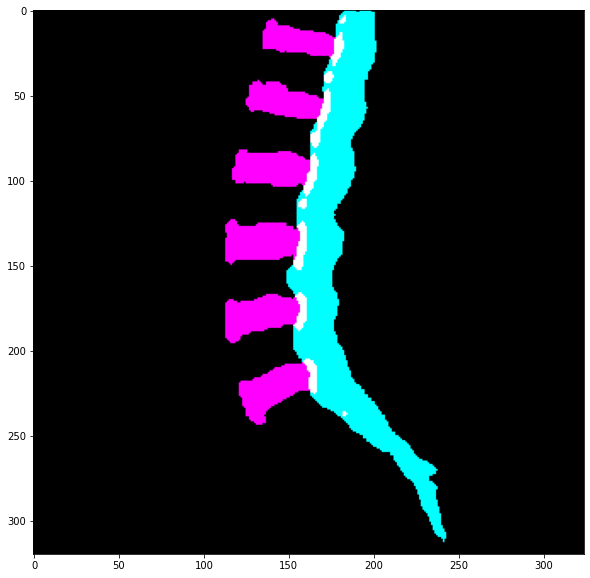

<Figure size 1440x1440 with 0 Axes>

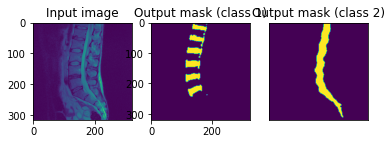

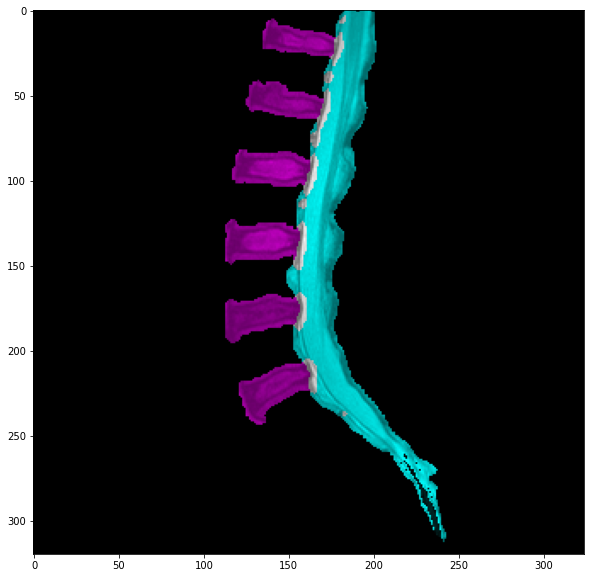

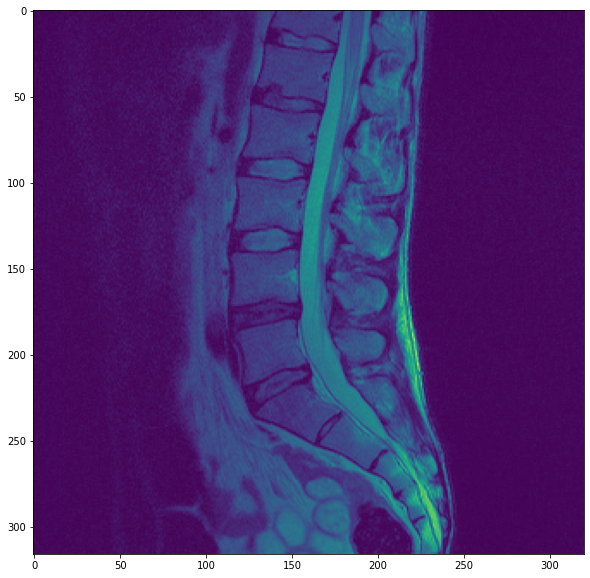

------------------------------------------------------------------------------------------

00256.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

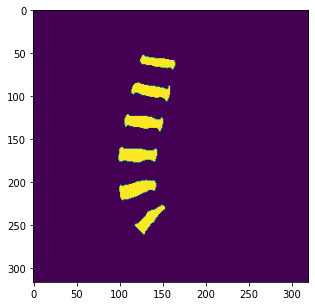

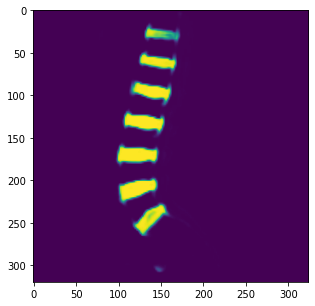

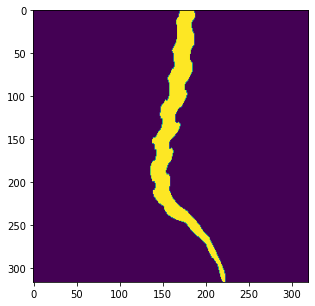

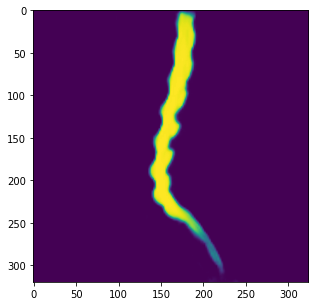

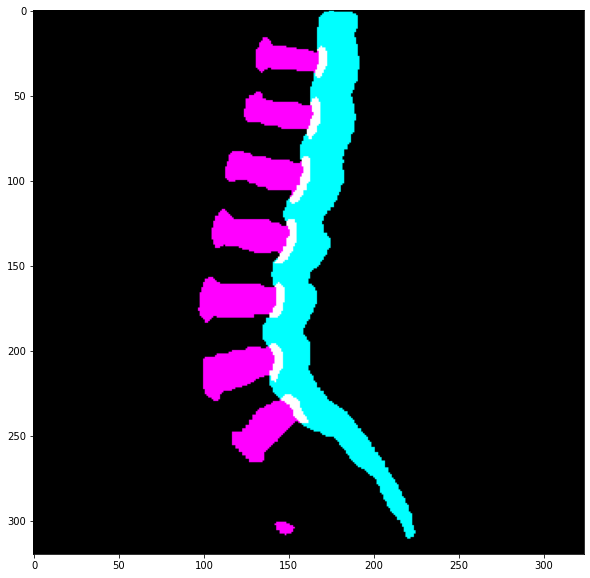

<Figure size 1440x1440 with 0 Axes>

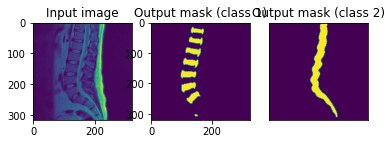

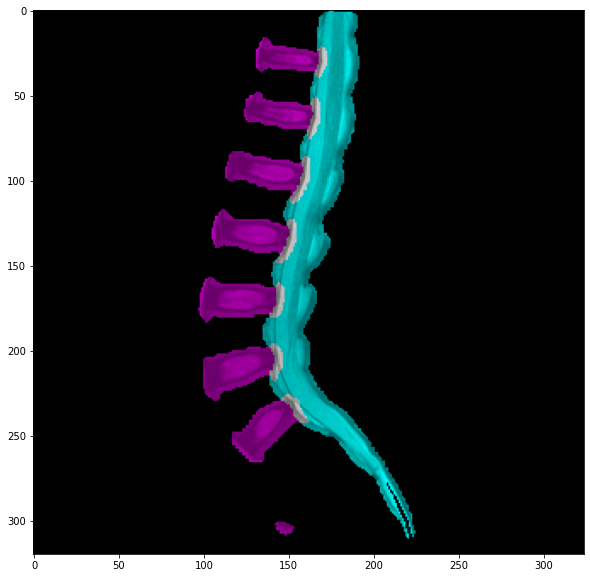

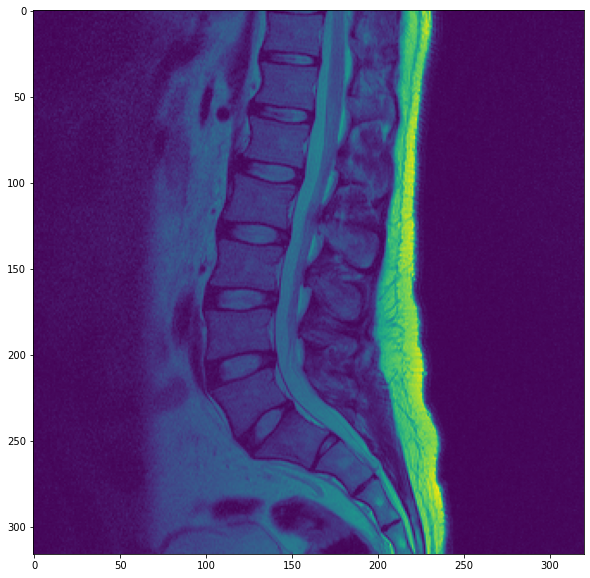

------------------------------------------------------------------------------------------

00103.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

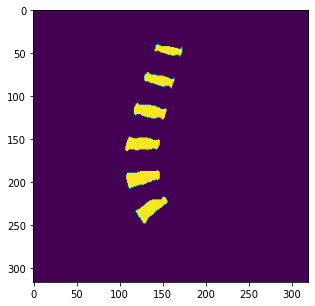

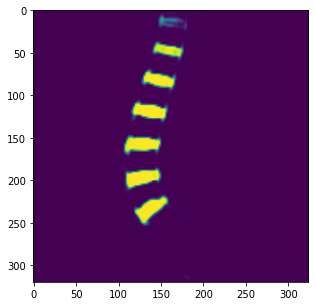

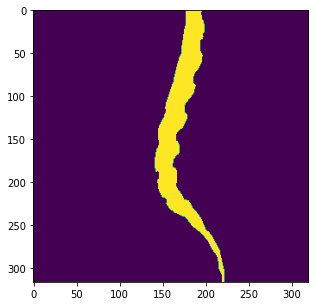

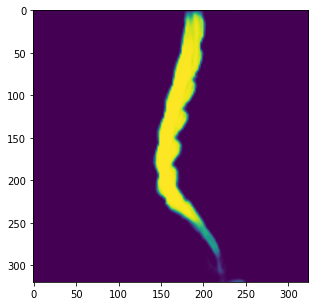

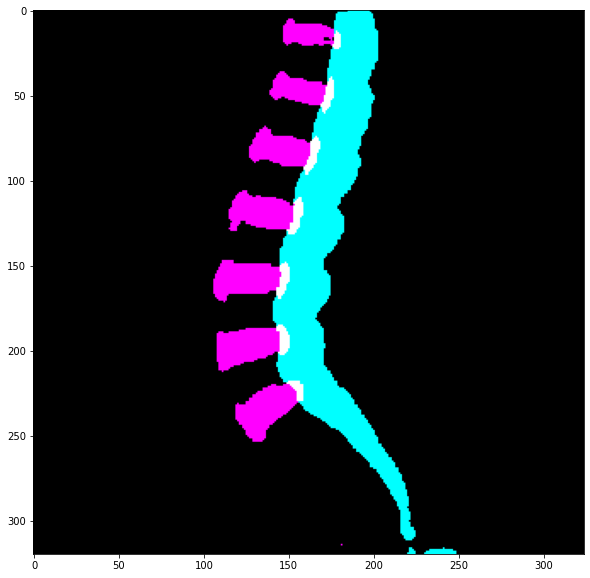

<Figure size 1440x1440 with 0 Axes>

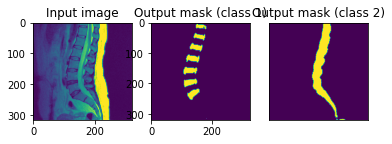

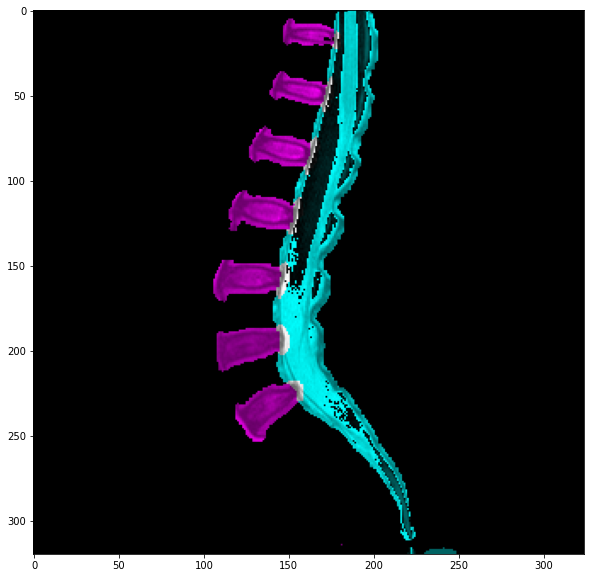

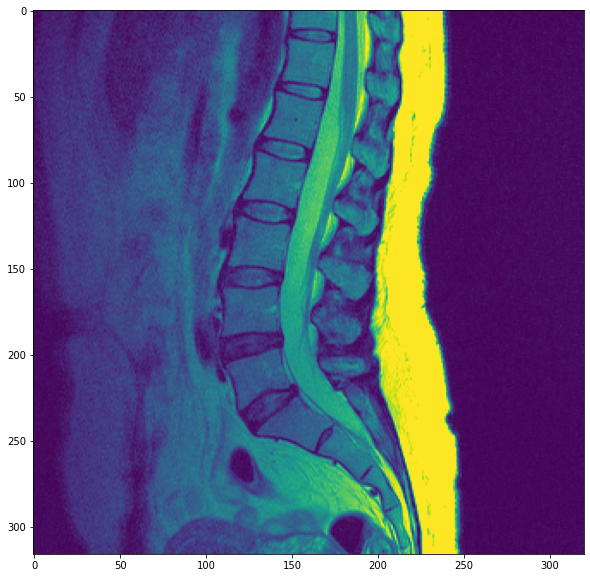

------------------------------------------------------------------------------------------

00075.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

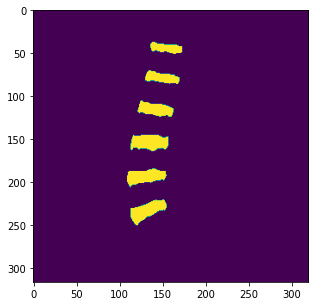

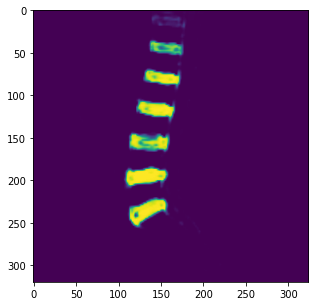

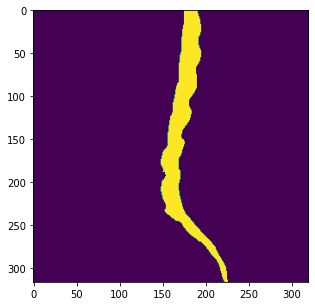

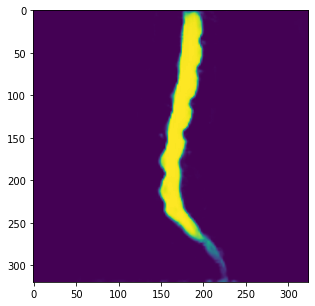

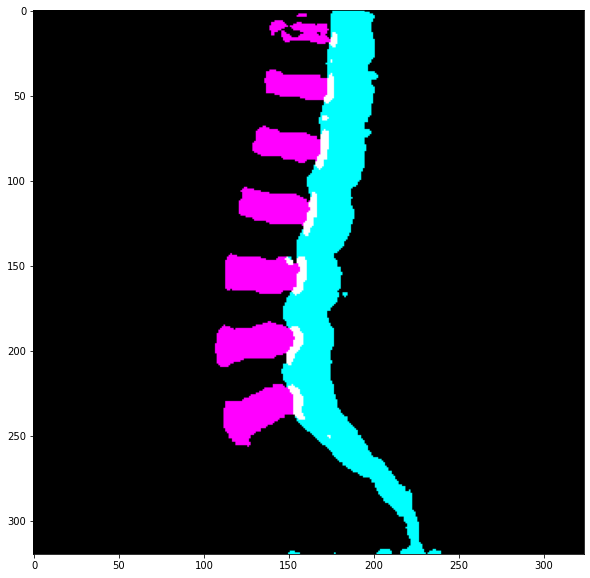

<Figure size 1440x1440 with 0 Axes>

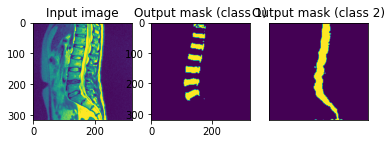

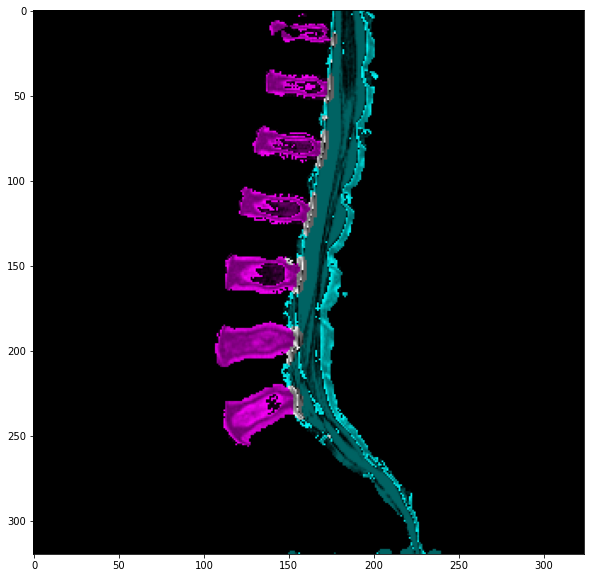

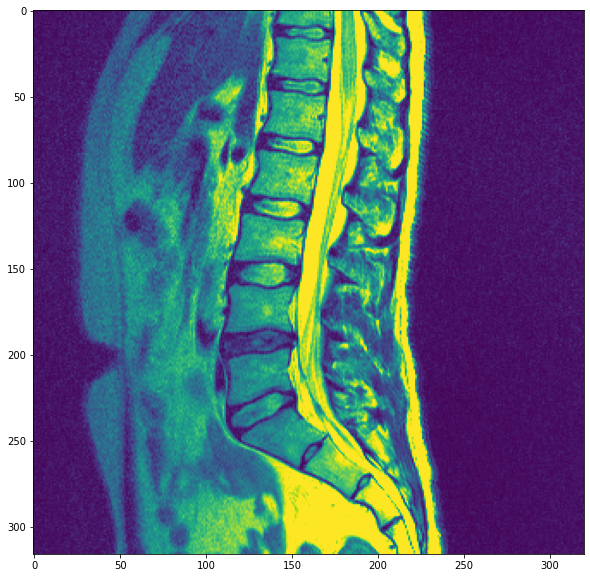

------------------------------------------------------------------------------------------

00228.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

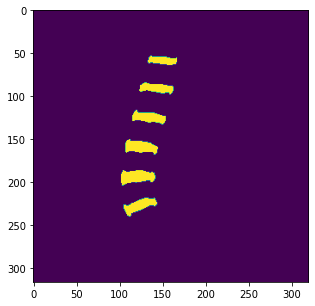

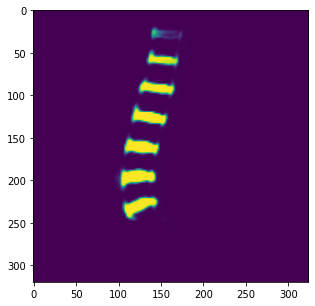

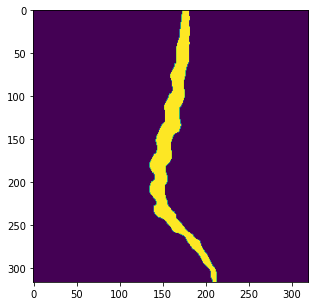

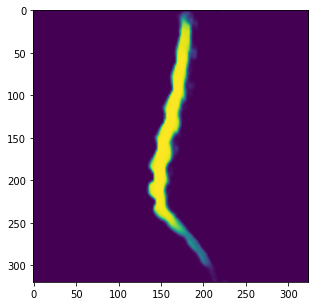

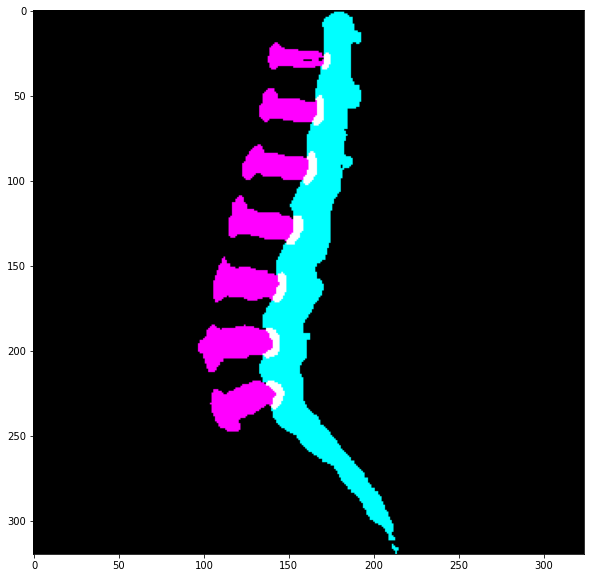

<Figure size 1440x1440 with 0 Axes>

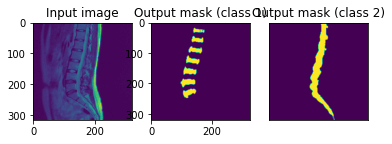

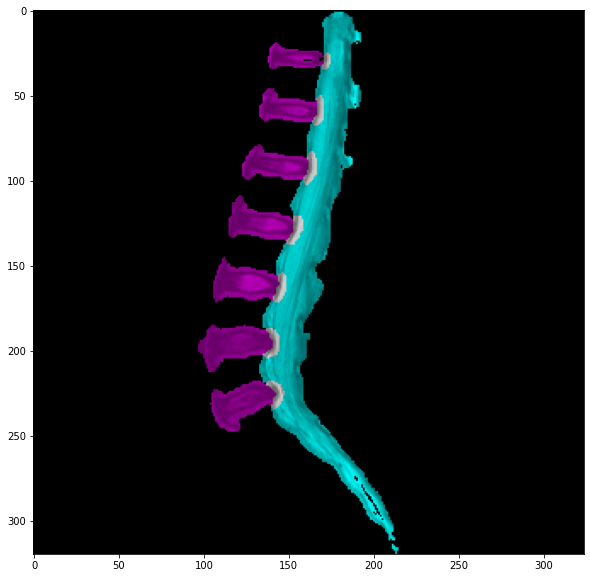

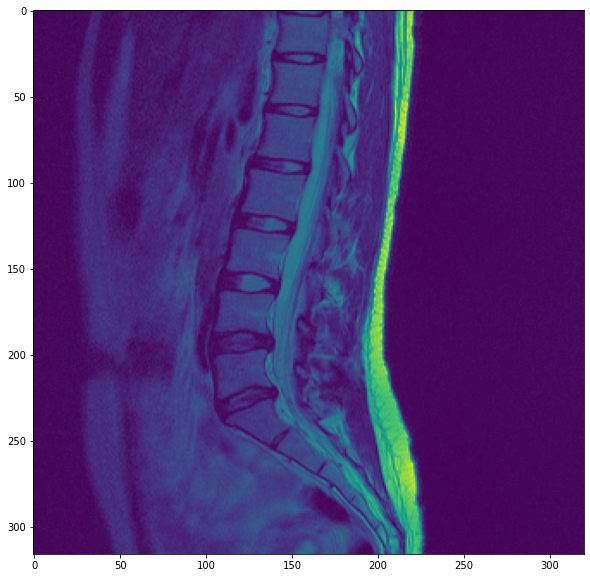

------------------------------------------------------------------------------------------

00217.PNG
torch.Size([1, 2, 158, 160])
(2, 320, 324)
[0.         0.00392157 0.00784314 0.01176471 0.01568628 0.01960784
 0.02352941 0.02745098 0.03137255 0.03529412 0.03921569 0.04313726
 0.04705882 0.05098039 0.05490196 0.05882353 0.0627451  0.06666667
 0.07058824 0.07450981 0.07843138 0.08235294 0.08627451 0.09019608
 0.09411765 0.09803922 0.10196079 0.10588235 0.10980392 0.11372549
 0.11764706 0.12156863 0.1254902  0.12941177 0.13333334 0.13725491
 0.14117648 0.14509805 0.14901961 0.15294118 0.15686275 0.16078432
 0.16470589 0.16862746 0.17254902 0.1764706  0.18039216 0.18431373
 0.1882353  0.19215687 0.19607843 0.2        0.20392157 0.20784314
 0.21176471 0.21568628 0.21960784 0.22352941 0.22745098 0.23137255
 0.23529412 0.23921569 0.24313726 0.24705882 0.2509804  0.25490198
 0.25882354 0.2627451  0.26666668 0.27058825 0.27450982 0.2784314
 0.28235295 0.28627452 0.2901961  0.29411766 0.29803

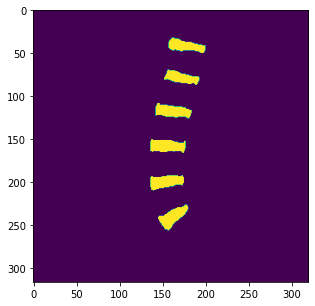

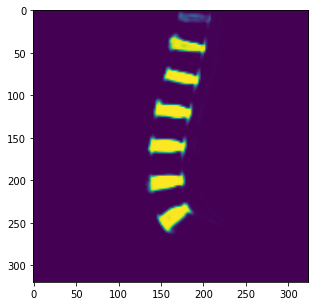

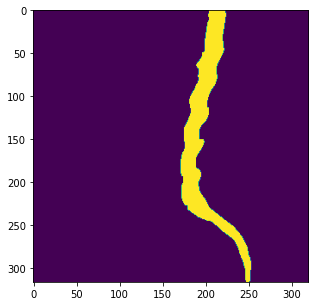

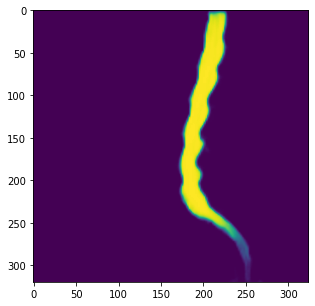

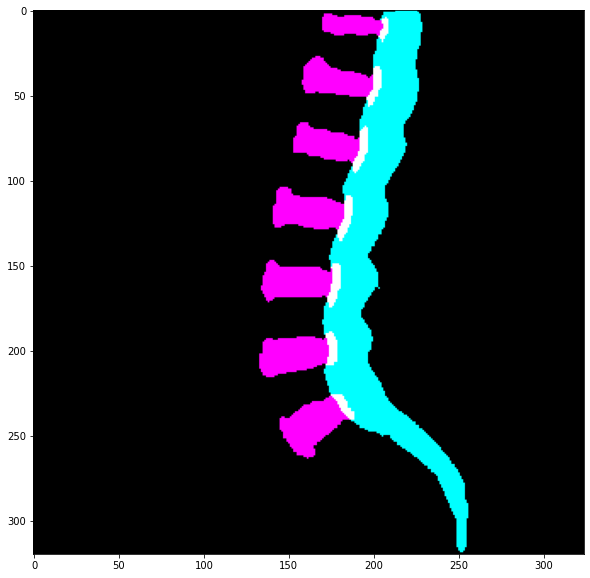

<Figure size 1440x1440 with 0 Axes>

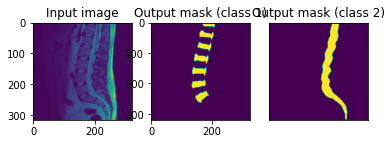

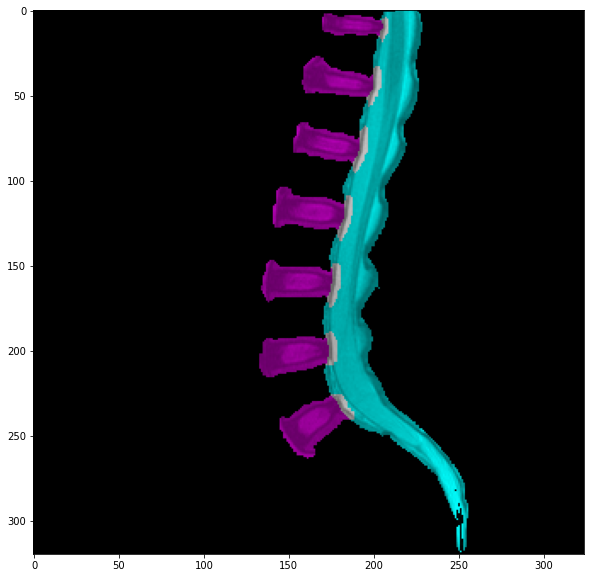

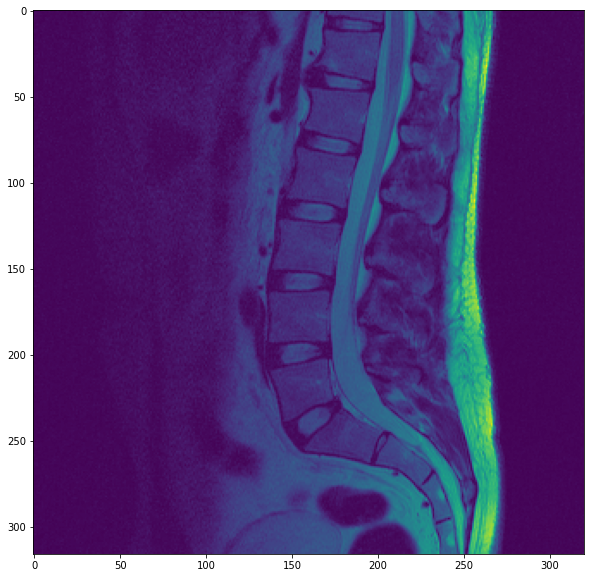

------------------------------------------------------------------------------------------



In [11]:
for i in range(30):
    
    choise = random.choice(infile_list)
    in_files = indirimg + choise
    in_masks = imdirmask + choise
    print(choise)

    img = Image.open(in_files)
    img

    mask = predict_img(net=net,
                       full_img=img,
                       scale_factor=scale,
                       out_threshold=mask_threshold,
                       device=device)

    print(mask.shape)
    print(np.unique(mask))

    true_mask = cv2.imread(in_masks)
    print(np.unique(true_mask))

    plt.figure(figsize=(5,5))
    plt.imshow(true_mask[:,:,0] * 255)
    plt.show()
    plt.figure(figsize=(5,5))
    plt.imshow(mask[0])
    plt.show()

    true_mask = cv2.imread(in_masks)
    plt.figure(figsize=(5,5))
    plt.imshow(true_mask[:,:,1] * 255)
    plt.show()
    plt.figure(figsize=(5,5))
    plt.imshow(mask[1])
    plt.show()

    ########
    ### change the threshold param for better / worse results

    res_treshold = 0.05
    mask = np.array([mask[0] > res_treshold, mask[1] > res_treshold])

    ########

    plt.figure(figsize=(10,10))
    plt.imshow(np.moveaxis(np.array([mask[0,:,:] * 255,
                                     mask[1,:,:] * 255,
                                     (mask[0,:,:] + mask[1,:,:]) * 255]
                                   ),
                           0, 2)
              )
    plt.show()


    plt.figure(figsize=(20,20))
    plot_img_and_mask(img, mask)

    np_img = np.array(img.resize((mask[0].shape[1], mask[0].shape[0]))) +100

    plt.figure(figsize=(10,10))
    plt.imshow(np.moveaxis(np.array([mask[0,:,:] * np_img,
                                     mask[1,:,:] * np_img,
                                     (mask[0,:,:] + mask[1,:,:]) * np_img]
                                   ),
                           0, 2)
              )
    plt.show()

    plt.figure(figsize=(10,10))
    plt.imshow(img
              )
    plt.show()
    
    print('------------------------------------------------------------------------------------------\n')